# Import Libraries & Set up Model

In [1]:
# use matplotlib for plotting
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import os.path
import warnings


import refnx, scipy

# the analysis module contains the curvefitting engine
from refnx.analysis import CurveFitter, Objective, Parameter, GlobalObjective, Parameters, process_chain, Transform, load_chain, possibly_create_parameter

# the reflect module contains functionality relevant to reflectometry
from refnx.reflect import SLD, ReflectModel, Structure, LipidLeaflet, Component, sld_profile

# the ReflectDataset object will contain the data
from refnx.dataset import ReflectDataset

import periodictable
from multiprocessing import Pool

# version numbers used in this analysis
refnx.version.version, scipy.version.version, np.version.version


('0.1.41', '1.11.4', '1.26.3')

In [2]:
# load all the 19 datasets to fit in the constrained model

S1_data_d2o_rt = ReflectDataset('S1 Si_dPC_RaLPS_D2O.dat')
S1_data_d2o_rt.name = "D2O_dataset"
S1_data_smw_rt = ReflectDataset('S1 Si_dPC_RaLPS_SMW.dat')
S1_data_smw_rt.name = "SMW_dataset"
S1_data_h2o_rt = ReflectDataset('S1 Si_dPC_RaLPS_H2O.dat')
S1_data_h2o_rt.name = "H2O_dataset"
S1_data_d2o_37 = ReflectDataset('S1 Si_dPC_RaLPS_37_D2O.dat')
S1_data_d2o_37.name = "D2O_dataset"
S1_data_smw_37 = ReflectDataset('S1 Si_dPC_RaLPS_37_SMW.dat')
S1_data_smw_37.name = "SMW_dataset"
S1_data_h2o_37 = ReflectDataset('S1 Si_dPC_RaLPS_37_H2O.dat')
S1_data_h2o_37.name = "H2O_dataset"
S1_data_d2o_pmb = ReflectDataset('S1 Si_dPC_RaLPS_37_D2O_100_PmB.dat')
S1_data_d2o_pmb.name = "D2O_dataset"
S1_data_smw_pmb = ReflectDataset('S1 Si_dPC_RaLPS_37_SMW_100_PmB.dat')
S1_data_smw_pmb.name = "SMW_dataset"
S1_data_h2o_pmb = ReflectDataset('S1 Si_dPC_RaLPS_37_H2O_100_PmB.dat')
S1_data_h2o_pmb.name = "H2O_dataset"


S3_data_d2o_rt = ReflectDataset('S3 Si_dPC_RaLPS_D2O.dat')
S3_data_d2o_rt.name = "D2O_dataset"
S3_data_smw_rt = ReflectDataset('S3 Si_dPC_RaLPS_SMW.dat')
S3_data_smw_rt.name = "SMW_dataset"
S3_data_h2o_rt = ReflectDataset('S3 Si_dPC_RaLPS_H2O.dat')
S3_data_h2o_rt.name = "H2O_dataset"
S3_data_d2o_37 = ReflectDataset('S3 Si_dPC_RaLPS_37_D2O.dat')
S3_data_d2o_37.name = "D2O_dataset"
S3_data_smw_37 = ReflectDataset('S3 Si_dPC_RaLPS_37_SMW.dat')
S3_data_smw_37.name = "SMW_dataset"
S3_data_h2o_37 = ReflectDataset('S3 Si_dPC_RaLPS_37_H2O.dat')
S3_data_h2o_37.name = "H2O_dataset"
S3_data_d2o_pmb = ReflectDataset('S3 Si_dPC_RaLPS_37_D2O PmB.dat')
S3_data_d2o_pmb.name = "D2O_dataset"
S3_data_smw_pmb = ReflectDataset('S3 Si_dPC_RaLPS_37_SMW PmB.dat')
S3_data_smw_pmb.name = "SMW_dataset"
S3_data_h2o_pmb = ReflectDataset('S3 Si_dPC_RaLPS_37_H2O PmB.dat')
S3_data_h2o_pmb.name = "H2O_dataset"



In [3]:
# Define model for the bilayer at room temperature
class Bilayer(Component):
    def __init__(self, *pars):
        super().__init__(name='Bilayer_RT')
        
        self.pnames = ['inner_head_hydration', 'pc_apm',
                       'outer_tails_thick', 'outer_tails_sld', 
                       'tails_hydration',
                       'outer_head_sld_ratio', 'outer_head_sld_d2o', 'outer_rough', 'core_thickness', 'core_hydration']
        
        self._pars = [possibly_create_parameter(a, name=pname) for pname, a in zip(self.pnames, pars)]        

        assert len(self._pars) == 10
        assert len(self.pnames) == 10
        
        for pname, a in zip(pnames, self._pars):
            setattr(self, pname, a)
    
        self._parameters = Parameters(data = self._pars, name=self.name)

    @property
    def parameters(self):
        return self._parameters

    def slabs(self, structure=None):
        """
        Slab representation of this component. See :class:`Component.slabs`
        """
        solvent = complex(structure.solvent)
        
        # calculate mole fraction of D2O from the bulk SLD
        rho_d2o = 6.35
        rho_h2o = -0.56
        d2o_molfr = (solvent - rho_h2o)/(rho_d2o - rho_h2o);
        
        #Neutron scattering lengths (b)
        bc = 0.6646e-4     #Carbon
        bo = 0.5843e-4     #Oxygen
        bh = -0.3739e-4    #Hydrogen
        bp = 0.513e-4      #Phosphorus
        bn = 0.936e-4      #Nitrogen
        bd = 0.6671e-4     #Deuterium
        bs = 0.2847e-4     #Sulphur
               
        #Total scattering length in each lipid fragment
        COO = (2*bo) + (bc)
        GLYC = (3*bc) + (5*bh)
        CH3 = (1*bc) + (3*bh)            
        PO4 = (1*bp) + (4*bo)
        CH2 = (1*bc) + (2*bh)
        CH = (1*bc) + (1*bh)
        CHOL = (5*bc) + (13*bh + (1*bn))
        H2O = (2*bh) + (1*bo)
        D2O = (2*bd) + (1*bo)
        CD2 = (1*bc) + (2*bd)
        CD3 = (1*bc) + (3*bd)
        
        #Molecular volumes
        vCH3 = 52.7
        vCH2 = 28.1
        vCOO = 39.0
        vGLYC = 68.8
        vPO4 = 53.7
        vCHOL = 120.4
        vWAT = 30.4
        vCH_CH = 42.14        

        #calculate DPPC molecular volumes
        v_inner_tails = 2 * (vCH3 + 14*vCH2)
        v_inner_heads = 2 * vCOO + vGLYC + vCHOL + vPO4
        
        sumb_inner_tails = 2 * (CD3 + 14*CD2)
        sumb_inner_heads = 2 * COO + GLYC + CHOL + PO4
        
        sld_inner_tails = (sumb_inner_tails / v_inner_tails)*10e5
        sld_inner_heads = (sumb_inner_heads / v_inner_heads)*10e5
        
        thick_inner_tails = v_inner_tails / self.pc_apm
        thick_inner_heads = v_inner_heads / self.pc_apm
                
        # Use D2O mol fraction to calculate SLD that exchange in D2O, 
        #the _ratio parameters define the ratios between the SLDs in D2O and the SLDs in H2O
        outer_head_sld = (self.outer_head_sld_d2o.value * d2o_molfr)
        outer_head_sld += (1 - d2o_molfr)*(self.outer_head_sld_ratio.value * self.outer_head_sld_d2o.value)
        
        # Account for bilayer hydration
        rhoInnerHead = self.inner_head_hydration.value * solvent
        rhoInnerHead += (1 - self.inner_head_hydration.value) * sld_inner_heads

        rhoInnerTails = self.tails_hydration.value * solvent 
        rhoInnerTails += (1 - self.tails_hydration.value) * sld_inner_tails

        rhoOuterTails = self.tails_hydration.value * solvent 
        rhoOuterTails += (1- self.tails_hydration.value) * self.outer_tails_sld.value
        
        rhoOuterHead = self.core_hydration.value * solvent
        rhoOuterHead += (1 - self.core_hydration.value) * outer_head_sld
        
        orough = self.outer_rough.value

        bilayer_rt = np.array([
            [thick_inner_heads, np.real(rhoInnerHead), np.imag(0), orough, 0],
            [thick_inner_tails, np.real(rhoInnerTails), np.imag(0), orough, 0],
            [self.outer_tails_thick.value, np.real(rhoOuterTails), np.imag(0), orough, 0],
            [self.core_thickness.value, np.real(rhoOuterHead), np.imag(0), orough, 0],
        ], dtype=float)
    
        return np.r_[bilayer_rt]


In [4]:
# Define parameters values, whether they are fitted or fixed and within which bounds

pnames = [  'inner_head_hydration', 'pc_apm',
            'outer_tails_thick', 'outer_tails_sld', 
            'tails_hydration',
            'outer_head_sld_ratio', 'outer_head_sld_d2o', 'outer_rough', 'core_thickness', 'core_hydration',]

# Create Parameter objects to share between conditions. Reuse a Parameter object if it's common.
#create a set of parameters for the bilayer at RT.
base_pars = [('inner_head_hydration',  0.32, True, (0.2, 0.6)),
             ('pc_apm',                55,   True, (0, 100)),
             ('outer_tails_thick',     14,   True, (12, 20)),
             ('outer_tails_sld',       6,    True, (4, 8)),
             ('tails_hydration',       0.02, True, (0, 0.5)),
             ('outer_head_sld_ratio',  0.5,  False, (0.4, 0.6)),
             ('outer_head_sld_d2o',    4.8,  True, (4, 7)),
             ('outer_rough',           5,    True, (3, 8)),
             ('core_thickness',        28,   True, (20, 40)),
             ('core_hydration',        0.48, True, (0, 1)),
            ]

pars = {p[0]: Parameter(value=p[1], vary=p[2], bounds=p[3], name=p[0]) for p in base_pars}

a = Bilayer(*(pars.values())) 

In [5]:
#Create the new Parameters for the bilayer at 37 deg that are not shared/common with RT:

pc_apm_37 = Parameter(55, vary=True, name='pc_apm_37', bounds=(0, 100))
pars['pc_apm'] = pc_apm_37

outer_tails_thick_37 = Parameter(12, vary=True, name='outer_tails_thick_37', bounds=(10, 20))
pars['outer_tails_thick'] = outer_tails_thick_37

outer_tails_sld_37 = Parameter(5, vary=True, name='outer_tails_sld_37', bounds=(4, 7))
pars['outer_tails_sld'] = outer_tails_sld_37

tails_hydration_37 = Parameter(0, vary=True, name='tails_hydration_37', bounds=(0, 0.3))
pars['tails_hydration'] = tails_hydration_37

core_thickness_37 = Parameter(25, vary=True, name='core_thickness_37', bounds=(20, 35))
pars['core_thickness'] = core_thickness_37

core_hydration_37 = Parameter(0.3, vary=True, name='core_hydration_37', bounds=(0.2, 0.7))
pars['core_hydration'] = core_hydration_37

outer_rough_37 = Parameter(4, vary=True, name='outer_rough_37', bounds=(2, 8))
pars['outer_rough'] = outer_rough_37

b = Bilayer(*(pars.values())) 

In [6]:
# Define mdoel for the bilayer at 37 C in the presence of PmB
# accounting for PmB volume fractiions intercalated in the four regions of the bilayer
# PmB volume fractions are defined as follows:
# pmb_vf1 -> PmB in the LPS headgroup
# pmb_vf2 -> PmB in the LPS tails
# pmb_vf3 -> PmB in the PC tails
# pmb_vf4 -> PmB in the PC headgroup

class Bilayer_PmB(Component):
    def __init__(self, *pars):
        super().__init__(name='Bilayer_PmB')
        
        self.pnames = ['inner_head_hydration', 'pc_apm',
                       'outer_tails_thick', 'outer_tails_sld', 
                       'tails_hydration',
                       'outer_head_sld_ratio', 'outer_head_sld_d2o', 'outer_rough', 'core_thickness', 'core_hydration',
                       'pmb_sld_d2o', 'pmb_sld_ratio', 'pmb_vf1', 'pmb_vf2', 'pmb_vf3', 'pmb_vf4']

        assert len(pars) == len(self.pnames) == 16
        self._pars = [possibly_create_parameter(c, name=pname) for pname, c in zip(self.pnames, pars)]        
        
        for pname, c in zip(pnames, self._pars):
            setattr(self, pname, c)
    
        
        self._parameters = Parameters(data = self._pars, name=self.name)

    @property
    def parameters(self):
        return self._parameters

    def slabs(self, structure=None):
        """
        Slab representation of this component. See :class:`Component.slabs`
        """
        solvent = complex(structure.solvent)
        
        # calculate mole fraction of D2O from the bulk SLD
        rho_d2o = 6.35
        rho_h2o = -0.56
        d2o_molfr = (solvent - rho_h2o)/(rho_d2o - rho_h2o);
        
        
        #Neutron b's..
        #define all the neut#on b's.
        bc = 0.6646e-4     #Carbon
        bo = 0.5843e-4     #Oxygen
        bh = -0.3739e-4    #Hydrogen
        bp = 0.513e-4      #Phosphorus
        bn = 0.936e-4      #Nitrogen
        bd = 0.6671e-4     #Deuterium
        bs = 0.2847e-4     #Sulphur
               
        #Total scattering length in each fragment
        COO = (2*bo) + (bc)
        GLYC = (3*bc) + (5*bh)
        CH3 = (1*bc) + (3*bh)            
        PO4 = (1*bp) + (4*bo)
        CH2 = (1*bc) + (2*bh)
        CH = (1*bc) + (1*bh)
        CHOL = (5*bc) + (13*bh + (1*bn))
        H2O = (2*bh) + (1*bo)
        D2O = (2*bd) + (1*bo)
        CD2 = (1*bc) + (2*bd)
        CD3 = (1*bc) + (3*bd)
        
        #Molecular volumes
        vCH3 = 52.7
        vCH2 = 28.1
        vCOO = 39.0
        vGLYC = 68.8
        vPO4 = 53.7
        vCHOL = 120.4
        vWAT = 30.4
        vCH_CH = 42.14        
        
        v_inner_tails = 2 * (vCH3 + 14*vCH2)
        v_inner_heads = 2*vCOO + vGLYC + vCHOL + vPO4
        
        sumb_inner_tails = 2 * (CD3 + 14*CD2)
        sumb_inner_heads = 2*COO + GLYC + CHOL + PO4
        
        sld_inner_tails = (sumb_inner_tails / v_inner_tails)*10e5
        sld_inner_heads = (sumb_inner_heads / v_inner_heads)*10e5
        
        thick_inner_tails = v_inner_tails / self.pc_apm
        thick_inner_heads = v_inner_heads / self.pc_apm        
                
        # Use D2O mol fraction to calculate SLD that exchange in D2O, the _ratio parameters define the ratios between the SLDs in D2O and the SLDs in H2O
        outer_head_sld = (self.outer_head_sld_d2o.value * d2o_molfr)
        outer_head_sld += (1 - d2o_molfr)*(self.outer_head_sld_ratio.value * self.outer_head_sld_d2o.value)
        
        pmb_sld = (self.pmb_sld_d2o.value * d2o_molfr)
        pmb_sld += (1 - d2o_molfr) * (self.pmb_sld_ratio.value * self.pmb_sld_d2o.value)
        
        
        # Account for bilayer hydration
        rhoInnerHead =  self.inner_head_hydration.value * solvent
        rhoInnerHead += self.pmb_vf4.value * pmb_sld
        rhoInnerHead += (1 - (self.inner_head_hydration.value + self.pmb_vf4.value)) * sld_inner_heads

        rhoInnerTails =  self.tails_hydration.value * solvent 
        rhoInnerTails += self.pmb_vf3.value * pmb_sld
        rhoInnerTails += (1 - (self.tails_hydration.value + self.pmb_vf3.value)) * sld_inner_tails

        rhoOuterTails =   self.tails_hydration.value * solvent 
        rhoOuterTails +=  self.pmb_vf2.value * pmb_sld
        rhoOuterTails +=  (1 - (self.tails_hydration.value + self.pmb_vf2.value)) * self.outer_tails_sld.value
        
        rhoOuterHead =  self.core_hydration.value * solvent
        rhoOuterHead += self.pmb_vf1.value * pmb_sld
        rhoOuterHead += (1 - (self.core_hydration.value + self.pmb_vf1.value)) * outer_head_sld
        
        orough = self.outer_rough.value
        
        bilayer_pmb = np.array([
            [thick_inner_heads, np.real(rhoInnerHead), np.imag(0), orough, 0],
            [thick_inner_tails, np.real(rhoInnerTails), np.imag(0), orough, 0],
            [self.outer_tails_thick.value, np.real(rhoOuterTails), np.imag(0), orough, 0],
            [self.core_thickness.value, np.real(rhoOuterHead), np.imag(0), orough, 0],
        ], dtype=float)
    
        return np.r_[bilayer_pmb]
       

In [7]:
# Define parameters values, whether they are fitted or fixed and within which bounds
# for the bilayer at 37C in the presence of PmB (direct injection of 100 ug/ml)
# PmB volume fractions are defined as follows:
# pmb_vf1 -> PmB in the LPS headgroup
# pmb_vf2 -> PmB in the LPS tails
# pmb_vf3 -> PmB in the PC tails
# pmb_vf4 -> PmB in the PC headgroup

pnames = [ 'inner_head_hydration', 'pc_apm',
           'outer_tails_thick', 'outer_tails_sld', 
           'tails_hydration',
           'outer_head_sld_ratio', 'outer_head_sld_d2o', 'outer_rough', 'core_thickness', 'core_hydration',
           'pmb_sld_d2o', 'pmb_sld_ratio', 'pmb_vf1', 'pmb_vf2', 'pmb_vf3', 'pmb_vf4']


S1_core_hydration_pmb = Parameter(0.3, vary=True, name='S1_core_hydration_pmb', bounds=(0, 1))
pars['core_hydration'] = S1_core_hydration_pmb

S1_core_thickness_pmb = Parameter(25, vary=True, name='S1_core_thickness_pmb', bounds=(10, 35))
pars['core_thickness'] = S1_core_thickness_pmb

S1_tails_hydration_pmb = Parameter(0, vary=True, name='S1_tails_hydration_pmb', bounds=(0, 0.3))
pars['tails_hydration'] = S1_tails_hydration_pmb

S1_outer_rough_pmb = Parameter(4, vary=True, name='S1_outer_rough_pmb', bounds=(2, 8))
pars['outer_rough'] = S1_outer_rough_pmb


first = list(pars.values())


# Parameters relative to PmB penetration
second = [Parameter(2.2, vary=False, name='S1_pmb_sld_d2o', bounds=(2, 3)),
          Parameter(0.5, vary=False, name='S1_pmb_sld_ratio', bounds=(0, 1)),
          Parameter(0.1, vary=True, name= 'S1_pmb_vf1', bounds=(0, 0.5)),
          Parameter(0.1, vary=True, name= 'S1_pmb_vf2', bounds=(0, 0.5)),
          Parameter(0.1, vary=True, name= 'S1_pmb_vf3', bounds=(0, 0.5)),
          Parameter(0.1, vary=True, name= 'S1_pmb_vf4', bounds=(0, 0.5)),          
         ]
# combine parameters
combined = first + second

c = Bilayer_PmB(*(combined)) 

In [8]:
# Define parameters values, whether they are fitted or fixed and within which bounds
# for the bilayer at 37C in the presence of PmB (final step of the titration at 100 ug/ml)
# PmB volume fractions are defined as follows:
# pmb_vf1 -> PmB in the LPS headgroup
# pmb_vf2 -> PmB in the LPS tails
# pmb_vf3 -> PmB in the PC tails
# pmb_vf4 -> PmB in the PC headgroup

pnames = [ 'inner_head_hydration', 'pc_apm',
           'outer_tails_thick', 'outer_tails_sld', 
           'tails_hydration',
           'outer_head_sld_ratio', 'outer_head_sld_d2o', 'outer_rough', 'core_thickness', 'core_hydration',
           'pmb_sld_d2o', 'pmb_sld_ratio', 'pmb_vf1', 'pmb_vf2', 'pmb_vf3', 'pmb_vf4']


S3_core_hydration_pmb = Parameter(0.3, vary=True, name='S3_core_hydration_pmb', bounds=(0, 1))
pars['core_hydration'] = S3_core_hydration_pmb

S3_core_thickness_pmb = Parameter(25, vary=True, name='S3_core_thickness_pmb', bounds=(10, 35))
pars['core_thickness'] = S3_core_thickness_pmb

S3_tails_hydration_pmb = Parameter(0, vary=True, name='S3_tails_hydration_pmb', bounds=(0, 0.3))
pars['tails_hydration'] = S3_tails_hydration_pmb

S3_outer_rough_pmb = Parameter(4, vary=True, name='S3_outer_rough_pmb', bounds=(2, 8))
pars['outer_rough'] = S3_outer_rough_pmb


first = list(pars.values())


# Parameters relative to PmB penetration
second = [Parameter(2.2, vary=False, name='S3_pmb_sld_d2o', bounds=(2, 3)),
          Parameter(0.5, vary=False, name='S3_pmb_sld_ratio', bounds=(0, 1)),
          Parameter(0.1, vary=True, name= 'S3_pmb_vf1', bounds=(0, 0.5)),
          Parameter(0.1, vary=True, name= 'S3_pmb_vf2', bounds=(0, 0.5)),
          Parameter(0.1, vary=True, name= 'S3_pmb_vf3', bounds=(0, 0.5)),
          Parameter(0.1, vary=True, name= 'S3_pmb_vf4', bounds=(0, 0.5)),          
         ]

# combine parameters
combined = first + second

d = Bilayer_PmB(*(combined)) 

In [10]:
#Set substrate and bulk solvent parameters
si = SLD(2.07, 'Si')
sio2 = SLD(3.47, 'SiO2')

d2o = SLD(6.36, 'D2O')
h2o = SLD(-0.56, 'H2O')
smw = SLD(2.07, 'SMW')

d2o.real.setp(6.25, bounds=(6, 6.36), vary=True)
d2o.real.name='D2O SLD'

smw.real.setp(2.07, bounds=(1.5, 3), vary=True)
smw.real.name='SMW SLD'

h2o.real.setp(-0.56, bounds=(-0.56, 1), vary=True)
h2o.real.name='H2O SLD'


# create slabs for the silicon oxide layers in the two samples.

S1_l_sio2 = sio2(15, 3)
S3_l_sio2 = sio2(15, 3)

S1_l_sio2.thick.name = 'S1 SiO2 Thickness'
S1_l_sio2.thick.setp(13, bounds=(2, 30), vary=True)
S1_l_sio2.rough.name = name='S1 SiO2 Roughness'
S1_l_sio2.rough.setp(4, bounds=(0, 7), vary=True)
S1_l_sio2.vfsolv.name = 'S1 SiO2 Solvation'
S1_l_sio2.vfsolv.setp(0.1, bounds=(0., 0.5), vary=True)

S3_l_sio2.thick.name = 'S3 SiO2 Thickness'
S3_l_sio2.thick.setp(13, bounds=(2, 30), vary=True)
S3_l_sio2.rough.name = name='S3 SiO2 Roughness'
S3_l_sio2.rough.setp(4, bounds=(0, 7), vary=True)
S3_l_sio2.vfsolv.name = 'S3 SiO2 Solvation'
S3_l_sio2.vfsolv.setp(0.1, bounds=(0., 0.5), vary=True)





# S1 Bilayer used for direct injection of 100 ug/ml PmB
S1_s_d2o_rt =  si  | S1_l_sio2 | a | d2o(0, a.outer_rough)
S1_s_smw_rt =  si  | S1_l_sio2 | a | smw(0, a.outer_rough)
S1_s_h2o_rt =  si  | S1_l_sio2 | a | h2o(0, a.outer_rough)
S1_s_d2o_37 =  si  | S1_l_sio2 | b | d2o(0, b.outer_rough)
S1_s_smw_37 =  si  | S1_l_sio2 | b | smw(0, b.outer_rough)
S1_s_h2o_37 =  si  | S1_l_sio2 | b | h2o(0, b.outer_rough)
S1_s_d2o_pmb = si  | S1_l_sio2 | c | d2o(0, c.outer_rough)
S1_s_smw_pmb = si  | S1_l_sio2 | c | smw(0, c.outer_rough)
S1_s_h2o_pmb = si  | S1_l_sio2 | c | h2o(0, c.outer_rough)

# S1 Bilayer used for titration 
S3_s_d2o_rt =  si  | S3_l_sio2 | a | d2o(0, a.outer_rough)
S3_s_smw_rt =  si  | S3_l_sio2 | a | smw(0, a.outer_rough)
S3_s_h2o_rt =  si  | S3_l_sio2 | a | h2o(0, a.outer_rough)
S3_s_d2o_37 =  si  | S3_l_sio2 | b | d2o(0, b.outer_rough)
S3_s_smw_37 =  si  | S3_l_sio2 | b | smw(0, b.outer_rough)
S3_s_h2o_37 =  si  | S3_l_sio2 | b | h2o(0, b.outer_rough)
S3_s_d2o_pmb = si  | S3_l_sio2 | d | d2o(0, d.outer_rough)
S3_s_smw_pmb = si  | S3_l_sio2 | d | smw(0, d.outer_rough)
S3_s_h2o_pmb = si  | S3_l_sio2 | d | h2o(0, d.outer_rough)


In [11]:
# Define scale factors and background parameters
S1_scale_rt = Parameter(1, 'S1_scale_rt')
S1_scale_rt.setp(0.8158, bounds=(0.8, 1.2), vary=True)
S1_scale_37 = Parameter(1, 'S1_scale_37')
S1_scale_37.setp(0.8158, bounds=(0.8, 1.2), vary=True)
S1_scale_pmb = Parameter(1, 'S1_scale_pmb')
S1_scale_pmb.setp(0.8158, bounds=(0.8, 1.2), vary=True)

S3_scale_rt = Parameter(1, 'S3_scale_rt')
S3_scale_rt.setp(0.8158, bounds=(0.8, 1.2), vary=True)
S3_scale_37 = Parameter(1, 'S3_scale_37')
S3_scale_37.setp(0.8158, bounds=(0.8, 1.2), vary=True)
S3_scale_pmb = Parameter(1, 'S3_scale_pmb')
S3_scale_pmb.setp(0.8158, bounds=(0.8, 1.2), vary=True)



# background for measurements in D2O
bkg1 = Parameter(1e-6, 'Bkg1')
bkg1.setp(1e-6, bounds=(1e-8, 6e-6), vary=True)

# background for measurements in SMW
bkg2 = Parameter(1e-6, 'Bkg2')
bkg2.setp(1e-6, bounds=(1e-8, 6e-6), vary=True)

# background for measurements in H2O
bkg3 = Parameter(1e-6, 'Bkg3')
bkg3.setp(1e-6, bounds=(1e-8, 6e-6), vary=True)


# Create model by combining structures with scale factors, background and resolution parameters
S1_model_d2o_rt =  ReflectModel(S1_s_d2o_rt,  scale=S1_scale_rt,  bkg=bkg1,    dq=4, dq_type='constant')
S1_model_smw_rt =  ReflectModel(S1_s_smw_rt,  scale=S1_scale_rt,  bkg=bkg2,    dq=4, dq_type='constant')
S1_model_h2o_rt =  ReflectModel(S1_s_h2o_rt,  scale=S1_scale_rt,  bkg=bkg3,    dq=4, dq_type='constant')   
S1_model_d2o_37 =  ReflectModel(S1_s_d2o_37,  scale=S1_scale_37,  bkg=bkg1,    dq=4, dq_type='constant')
S1_model_smw_37 =  ReflectModel(S1_s_smw_37,  scale=S1_scale_37,  bkg=bkg2,    dq=4, dq_type='constant')
S1_model_h2o_37 =  ReflectModel(S1_s_h2o_37,  scale=S1_scale_37,  bkg=bkg3,    dq=4, dq_type='constant')
S1_model_d2o_pmb = ReflectModel(S1_s_d2o_pmb, scale=S1_scale_pmb, bkg=bkg1,    dq=4, dq_type='constant')
S1_model_smw_pmb = ReflectModel(S1_s_smw_pmb, scale=S1_scale_pmb, bkg=bkg2,    dq=4, dq_type='constant')
S1_model_h2o_pmb = ReflectModel(S1_s_h2o_pmb, scale=S1_scale_pmb, bkg=bkg3,    dq=4, dq_type='constant')
 
S3_model_d2o_rt =  ReflectModel(S3_s_d2o_rt,  scale=S3_scale_rt,  bkg=bkg1,    dq=4, dq_type='constant')
S3_model_smw_rt =  ReflectModel(S3_s_smw_rt,  scale=S3_scale_rt,  bkg=bkg2,    dq=4, dq_type='constant')
S3_model_h2o_rt =  ReflectModel(S3_s_h2o_rt,  scale=S3_scale_rt,  bkg=bkg3,    dq=4, dq_type='constant')   
S3_model_d2o_37 =  ReflectModel(S3_s_d2o_37,  scale=S3_scale_37,  bkg=bkg1,    dq=4, dq_type='constant')
S3_model_smw_37 =  ReflectModel(S3_s_smw_37,  scale=S3_scale_37,  bkg=bkg2,    dq=4, dq_type='constant')
S3_model_h2o_37 =  ReflectModel(S3_s_h2o_37,  scale=S3_scale_37,  bkg=bkg3,    dq=4, dq_type='constant')
S3_model_d2o_pmb = ReflectModel(S3_s_d2o_pmb, scale=S3_scale_pmb, bkg=bkg1,    dq=4, dq_type='constant')
S3_model_smw_pmb = ReflectModel(S3_s_smw_pmb, scale=S3_scale_pmb, bkg=bkg2,    dq=4, dq_type='constant')
S3_model_h2o_pmb = ReflectModel(S3_s_h2o_pmb, scale=S3_scale_pmb, bkg=bkg3,    dq=4, dq_type='constant')



In [12]:
# define objectives by combining models and data

S1_objective_d2o_rt = Objective(  S1_model_d2o_rt,   S1_data_d2o_rt)
S1_objective_smw_rt = Objective(  S1_model_smw_rt,   S1_data_smw_rt)
S1_objective_h2o_rt = Objective(  S1_model_h2o_rt,   S1_data_h2o_rt)
S1_objective_d2o_37 = Objective(  S1_model_d2o_37,   S1_data_d2o_37)
S1_objective_smw_37 = Objective(  S1_model_smw_37,   S1_data_smw_37)
S1_objective_h2o_37 = Objective(  S1_model_h2o_37,   S1_data_h2o_37)
S1_objective_d2o_pmb = Objective( S1_model_d2o_pmb,  S1_data_d2o_pmb)
S1_objective_smw_pmb = Objective( S1_model_smw_pmb,  S1_data_smw_pmb)
S1_objective_h2o_pmb = Objective( S1_model_h2o_pmb,  S1_data_h2o_pmb)

S3_objective_d2o_rt = Objective(  S3_model_d2o_rt,   S3_data_d2o_rt)
S3_objective_smw_rt = Objective(  S3_model_smw_rt,   S3_data_smw_rt)
S3_objective_h2o_rt = Objective(  S3_model_h2o_rt,   S3_data_h2o_rt)
S3_objective_d2o_37 = Objective(  S3_model_d2o_37,   S3_data_d2o_37)
S3_objective_smw_37 = Objective(  S3_model_smw_37,   S3_data_smw_37)
S3_objective_h2o_37 = Objective(  S3_model_h2o_37,   S3_data_h2o_37)
S3_objective_d2o_pmb = Objective( S3_model_d2o_pmb,  S3_data_d2o_pmb)
S3_objective_smw_pmb = Objective( S3_model_smw_pmb,  S3_data_smw_pmb)
S3_objective_h2o_pmb = Objective( S3_model_h2o_pmb,  S3_data_h2o_pmb)

S1_objective_h2o_rt.weighted = S1_objective_smw_rt.weighted = S1_objective_d2o_rt.weighted = S1_objective_h2o_37.weighted = S1_objective_smw_37.weighted = S1_objective_d2o_37.weighted = S1_objective_h2o_pmb.weighted = S1_objective_smw_pmb.weighted = S1_objective_d2o_pmb.weighted = True
S3_objective_h2o_rt.weighted = S3_objective_smw_rt.weighted = S3_objective_d2o_rt.weighted = S3_objective_h2o_37.weighted = S3_objective_smw_37.weighted = S3_objective_d2o_37.weighted = S3_objective_h2o_pmb.weighted = S3_objective_smw_pmb.weighted = S3_objective_d2o_pmb.weighted = True

#Define global objective by combining all objectives
global_objective = GlobalObjective([S1_objective_d2o_rt,  S1_objective_smw_rt,   S1_objective_h2o_rt, 
                                    S1_objective_d2o_37,  S1_objective_smw_37,   S1_objective_h2o_37, 
                                    S1_objective_d2o_pmb, S1_objective_smw_pmb,  S1_objective_h2o_pmb,
                                    S3_objective_d2o_rt,  S3_objective_smw_rt,   S3_objective_h2o_rt, 
                                    S3_objective_d2o_37,  S3_objective_smw_37,   S3_objective_h2o_37, 
                                    S3_objective_d2o_pmb, S3_objective_smw_pmb,  S3_objective_h2o_pmb])


# Structure

In [85]:
#Print slabs structure
S1_slabs_rt = a.slabs( S1_s_d2o_rt)
S1_slabs_37 = b.slabs( S1_s_d2o_37)
S1_slabs_pmb = c.slabs(S1_s_d2o_pmb)

S3_slabs_rt = a.slabs( S3_s_d2o_rt)
S3_slabs_37 = b.slabs( S3_s_d2o_37)
S3_slabs_pmb = d.slabs(S3_s_d2o_pmb)

# Display the slab representations
print("S1 RT Bilayer Slabs:")
print(S1_slabs_rt)

print("\nS1 37C Bilayer Slabs:")
print(S1_slabs_37)

print("\nS1 37C + PmB Bilayer Slabs:")
print(S1_slabs_pmb)

# Display the slab representations
print("\nS3 RT Bilayer Slabs:")
print(S3_slabs_rt)

print("\nS3 37C Bilayer Slabs:")
print(S3_slabs_37)

print("\nS3 37C + PmB Bilayer Slabs:")
print(S3_slabs_pmb)

S1 RT Bilayer Slabs:
[[ 6.54800159  4.02168035  0.          4.65226143  0.        ]
 [18.20544413  6.84526901  0.          4.65226143  0.        ]
 [16.20111618  6.00176753  0.          4.65226143  0.        ]
 [29.01845858  6.57972031  0.          4.65226143  0.        ]]

S1 37C Bilayer Slabs:
[[ 6.39064031  4.02168035  0.          4.36453178  0.        ]
 [17.76793171  6.84280321  0.          4.36453178  0.        ]
 [13.97193823  5.72740674  0.          4.36453178  0.        ]
 [29.22387003  6.51031884  0.          4.36453178  0.        ]]

S1 37C + PmB Bilayer Slabs:
[[ 6.39064031  4.0738519   0.          3.87019427  0.        ]
 [17.76793171  6.26481867  0.          3.87019427  0.        ]
 [13.97193823  4.61488613  0.          3.87019427  0.        ]
 [17.15171058  6.24280949  0.          3.87019427  0.        ]]

S3 RT Bilayer Slabs:
[[ 6.54800159  4.02168035  0.          4.65226143  0.        ]
 [18.20544413  6.84526901  0.          4.65226143  0.        ]
 [16.20111618  6.001

# Run Fit

In [55]:
fitter = CurveFitter(global_objective)

In [56]:
fitter.reset()

In [57]:
fitter.fit('differential_evolution', popsize=10, polish=True);

-13076.140956693356: : 241it [11:48,  2.94s/it]


# Plots

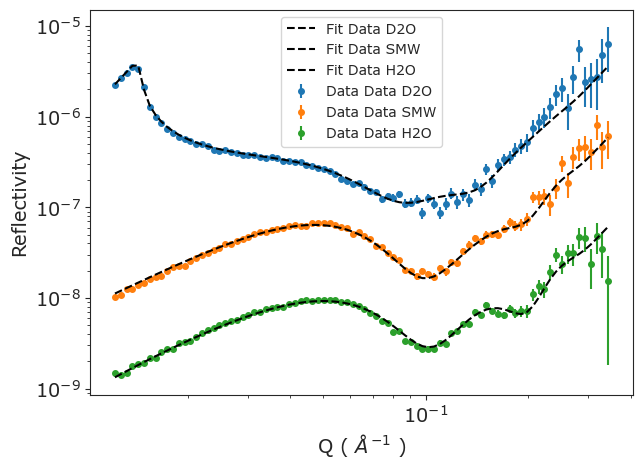

In [296]:
#Plot the obtained fits and corresponding datasets

# Define the offsets for each dataset
offsets = [2, 1, 0]
plt.rcParams['font.family'] = 'Verdana'

marksize = 4
color = 'black'

# Define the scaling function
def scale_y(y, x):
    return y * x**4 # for R*Q^4

# Function to apply vertical offset
def apply_vertical_offset(y, offset):
    return y * 10**offset

fig1 = plt.figure(figsize=(7, 5))

# Define a list of objectives and labels
objectives = [S1_objective_d2o_rt, S1_objective_smw_rt, S1_objective_h2o_rt] 
labels = ['Data D2O', 'Data SMW', 'Data H2O',]

# Loop over each objective and plot
for i, objective in enumerate(objectives):
    x, y, y_err = objective.data.x, objective.data.y, objective.data.y_err
    scaled_y = scale_y(apply_vertical_offset(y, offsets[i]), x)
    scaled_y_err = scale_y(apply_vertical_offset(y_err, offsets[i]), x)
    scaled_model_y = scale_y(apply_vertical_offset(objective.model(x), offsets[i]), x)

    plt.errorbar(x, scaled_y, scaled_y_err, label=f'Data {labels[i]}', fmt='o', markersize=marksize)
    plt.plot(x, scaled_model_y, label=f'Fit {labels[i]}', linestyle='--', color=color, zorder=10)

plt.yscale('log')
plt.xscale('log')
plt.legend(fontsize=10)
plt.xlabel('Q ( $Å^{-1}$ )', fontsize=14)
plt.ylabel('Reflectivity', fontsize=14)

plt.show()

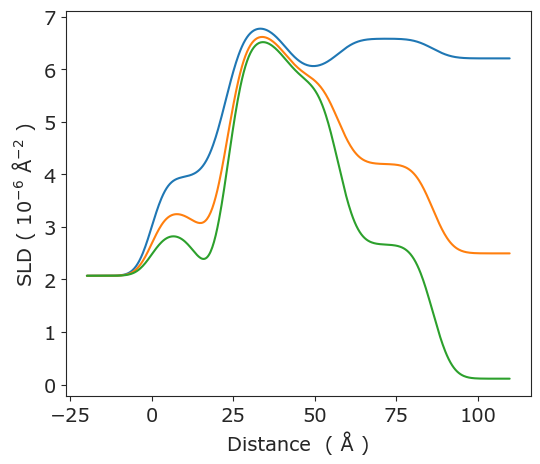

In [166]:
fig2, ax = plt.subplots(figsize=(6, 5))
ax.plot(*S1_s_d2o_rt.sld_profile(), label='SLD D2O')
ax.plot(*S1_s_smw_rt.sld_profile(), label='SLD SMW')
ax.plot(*S1_s_h2o_rt.sld_profile(), label='SLD H2O')


ax.set_ylabel("SLD ( $10^{-6}$ Å$^{-2}$ )")
ax.set_xlabel("Distance  ( Å )")
# ax.legend(fontsize=12)#bbox_to_anchor=(1.05, 1), loc='upper left')

plt.savefig('S1_SLD_RT.png', dpi=300, bbox_inches='tight', pad_inches=0.1)


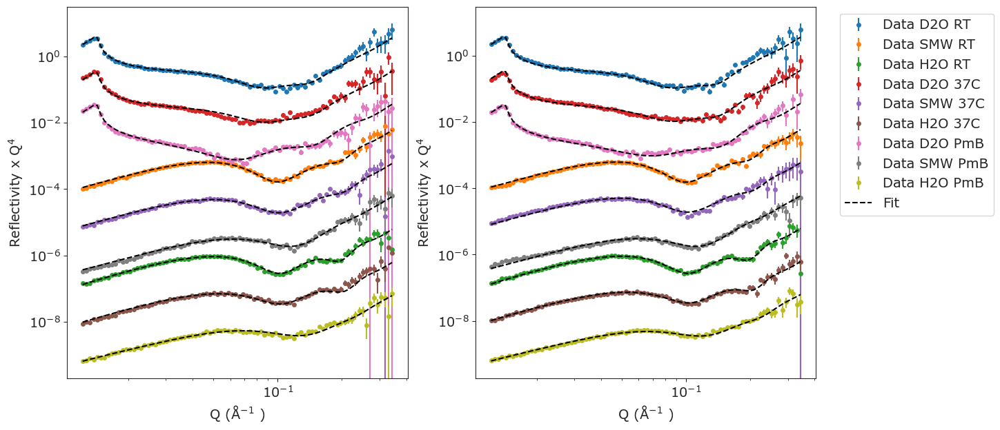

In [223]:
import matplotlib.pyplot as plt
import matplotlib.lines as mlines

plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14 

# Define the offsets for each dataset
offsets = [8, 5, 2, 7, 4, 1, 6, 3, 0]

marksize = 4
color = 'black'

# Define the scaling function
def scale_y(y, x):
    return y * x**4 # for R*Q^4

# Function to apply vertical offset
def apply_vertical_offset(y, offset):
    return y * 10**offset

fig, axs = plt.subplots(1, 2, figsize=(14, 7))

# Define a list of objectives and labels for S1 and S3
S1_objectives = [S1_objective_d2o_rt,  S1_objective_smw_rt,  S1_objective_h2o_rt, 
                 S1_objective_d2o_37,  S1_objective_smw_37,  S1_objective_h2o_37,
                 S1_objective_d2o_pmb, S1_objective_smw_pmb, S1_objective_h2o_pmb]
S1_labels = ['S1 D2O RT', 'S1 SMW RT', 'S1 H2O RT', 'S1 D2O 37', 'S1 SMW 37', 'S1 H2O 37', 'S1 D2O PmB', 'S1 SMW PmB', 'S1 H2O PmB']

S3_objectives = [S3_objective_d2o_rt,  S3_objective_smw_rt, S3_objective_h2o_rt, 
                 S3_objective_d2o_37,  S3_objective_smw_37, S3_objective_h2o_37,
                 S3_objective_d2o_pmb, S3_objective_smw_pmb,S3_objective_h2o_pmb]
S3_labels = ['D2O RT', 'SMW RT', 'H2O RT', 'D2O 37C', 'SMW 37C', 'H2O 37C', 'D2O PmB', 'SMW PmB', 'H2O PmB']

# Creating legends with all dataset entries and a single entry for the model fit
legend_elements_S1 = []
legend_elements_S3 = []

# Loop over each objective and plot S1 and S3 separately
for i, (S1_obj, S3_obj) in enumerate(zip(S1_objectives, S3_objectives)):
    x_S1, y_S1, y_err_S1 = S1_obj.data.x, S1_obj.data.y, S1_obj.data.y_err
    x_S3, y_S3, y_err_S3 = S3_obj.data.x, S3_obj.data.y, S3_obj.data.y_err

    scaled_y_S1 = scale_y(apply_vertical_offset(y_S1, offsets[i]), x_S1)
    scaled_y_err_S1 = scale_y(apply_vertical_offset(y_err_S1, offsets[i]), x_S1)
    scaled_model_y_S1 = scale_y(apply_vertical_offset(S1_obj.model(x_S1), offsets[i]), x_S1)

    scaled_y_S3 = scale_y(apply_vertical_offset(y_S3, offsets[i]), x_S3)
    scaled_y_err_S3 = scale_y(apply_vertical_offset(y_err_S3, offsets[i]), x_S3)
    scaled_model_y_S3 = scale_y(apply_vertical_offset(S3_obj.model(x_S3), offsets[i]), x_S3)

    data_line_S1 = axs[0].errorbar(x_S1, scaled_y_S1, scaled_y_err_S1, fmt='o', markersize=marksize)
    data_line_S3 = axs[1].errorbar(x_S3, scaled_y_S3, scaled_y_err_S3, fmt='o', markersize=marksize)

    axs[0].plot(x_S1, scaled_model_y_S1, linestyle='--', color=color, zorder=10)
    axs[1].plot(x_S3, scaled_model_y_S3, linestyle='--', color=color, zorder=10)

    # Add handles for legends
    legend_elements_S1.append((data_line_S1, f'{S1_labels[i]}'))
    legend_elements_S3.append((data_line_S3, f'Data {S3_labels[i]}'))

# Add a single model line to the legend
fit_handle = mlines.Line2D([], [], color=color, linestyle='--', label='Fit')

# Set y-axis and x-axis scaling for both panels
axs[0].set_yscale('log')
axs[1].set_yscale('log')
axs[0].set_xscale('log')
axs[1].set_xscale('log')

# Set labels and legends for both panels
axs[0].set_xlabel('Q (Å$^{-1}$ )', fontsize=14)
axs[0].set_ylabel('Reflectivity x Q$^{4}$', fontsize=14)
axs[1].set_xlabel('Q (Å$^{-1}$ )', fontsize=14)
axs[1].set_ylabel('Reflectivity x Q$^{4}$', fontsize=14)

# Creating legends
# axs[0].legend(handles=[fit_handle] + [line[0] for line in legend_elements_S1], labels=[fit_handle.get_label()] + [line[1] for line in legend_elements_S1], loc='upper left')
# axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', handles=[fit_handle] + [line[0] for line in legend_elements_S3], labels=[fit_handle.get_label()] + [line[1] for line in legend_elements_S3])
axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left', handles=[line[0] for line in legend_elements_S3] + [fit_handle], 
              labels=[line[1] for line in legend_elements_S3] + [fit_handle.get_label()], 
              )
plt.savefig('S1_S3_Ref_Panel_Figure_7', dpi=300, bbox_inches='tight')


plt.show()


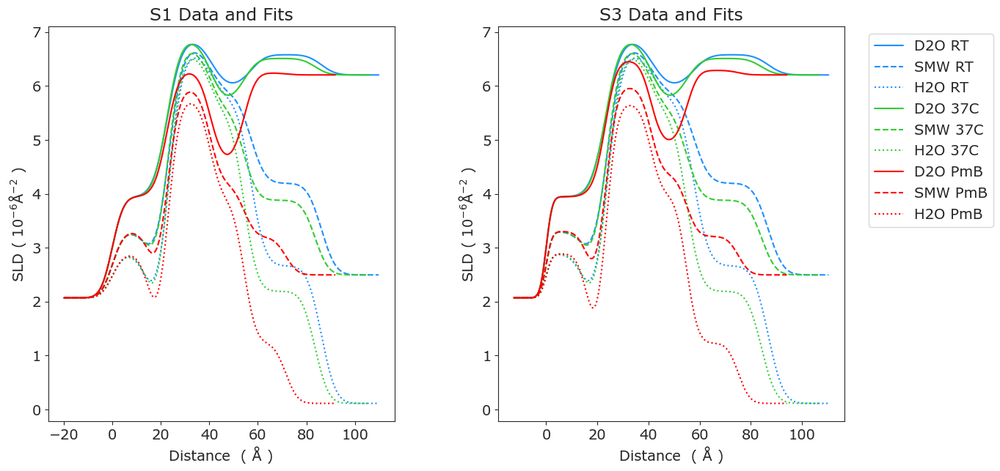

In [297]:
import matplotlib.pyplot as plt
plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14 


# Create a figure with two subplots (1 row, 2 columns)
fig, axs = plt.subplots(1, 2, figsize=(14, 7))

# Plot S1 data on the left panel
axs[0].plot(*S1_s_d2o_rt.sld_profile(),  label='D2O_RT'  , linestyle='-', color= 'dodgerblue')
axs[0].plot(*S1_s_smw_rt.sld_profile(),  label='SMW_RT'  , linestyle='--', color='dodgerblue')
axs[0].plot(*S1_s_h2o_rt.sld_profile(),  label='H2O_RT'  , linestyle=':', color= 'dodgerblue')
axs[0].plot(*S1_s_d2o_37.sld_profile(),  label='D2O_37'  , linestyle='-', color= 'limegreen')
axs[0].plot(*S1_s_smw_37.sld_profile(),  label='SMW_37'  , linestyle='--', color='limegreen')
axs[0].plot(*S1_s_h2o_37.sld_profile(),  label='H2O_37'  , linestyle=':', color= 'limegreen')
axs[0].plot(*S1_s_d2o_pmb.sld_profile(), label='D2O_PmB', linestyle='-', color='red')
axs[0].plot(*S1_s_smw_pmb.sld_profile(), label='SMW_PmB', linestyle='--', color='red')
axs[0].plot(*S1_s_h2o_pmb.sld_profile(), label='H2O_PmB', linestyle=':', color='red')

# Plot S3 data on the right panel
axs[1].plot(*S3_s_d2o_rt.sld_profile(),  label='D2O RT'  , linestyle='-', color= 'dodgerblue')
axs[1].plot(*S3_s_smw_rt.sld_profile(),  label='SMW RT'  , linestyle='--', color='dodgerblue')
axs[1].plot(*S3_s_h2o_rt.sld_profile(),  label='H2O RT'  , linestyle=':', color= 'dodgerblue')
axs[1].plot(*S3_s_d2o_37.sld_profile(),  label='D2O 37C'  , linestyle='-', color= 'limegreen')
axs[1].plot(*S3_s_smw_37.sld_profile(),  label='SMW 37C'  , linestyle='--', color='limegreen')
axs[1].plot(*S3_s_h2o_37.sld_profile(),  label='H2O 37C'  , linestyle=':', color= 'limegreen')
axs[1].plot(*S3_s_d2o_pmb.sld_profile(), label='D2O PmB', linestyle='-', color='red')
axs[1].plot(*S3_s_smw_pmb.sld_profile(), label='SMW PmB', linestyle='--', color='red')
axs[1].plot(*S3_s_h2o_pmb.sld_profile(), label='H2O PmB', linestyle=':', color='red')

# Set labels and legends for both panels
axs[0].set_ylabel("SLD ( $10^{-6}$Å$^{-2}$ )")
axs[0].set_xlabel("Distance  ( Å )")
# axs[0].legend(bbox_to_anchor=(2.35, 0.5), loc='upper left')
axs[0].set_title('S1 Data and Fits')

axs[1].set_ylabel("SLD ( $10^{-6}$Å$^{-2}$ )")
axs[1].set_xlabel("Distance  ( Å )")
axs[1].legend(bbox_to_anchor=(1.05, 1), loc='upper left')
axs[1].set_title('S3 Data and Fits')

# Optionally, adjust spacing between subplots
plt.subplots_adjust(wspace=0.3)

# Optionally, save the figure
plt.savefig('S1_S3_SLD_Panel_Figure_7', dpi=300, bbox_inches='tight')

plt.show()


# S1 VF Plots

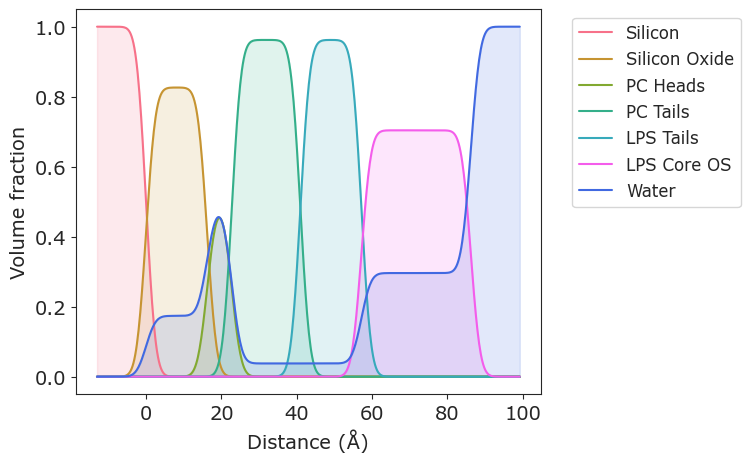

In [286]:
#Volume fraction plot of the bilayer at RT
import seaborn as sns

# Set style
sns.set_style('ticks')

# Add custom labels to this list
custom_labels = ["Silicon", "Silicon Oxide", "PC Heads", "PC Tails", "LPS Tails", 'LPS Core OS', "Water"]  # Example labels
plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14 



def create_vfp(structure, solvent_slab=-1, roughness=2, labels=None):
    _slabs = structure.slabs().copy()

    if roughness is not None:
        _slabs[:, 3] = roughness
        
    # Create an array of hydration values for each slab in the structure
    hydration_values = np.zeros(len(_slabs))

    # Assign hydration values only to the layers of the Paracini component
    hydration_values[1:6] = np.array([ S1_l_sio2.vfsolv,
                                       a.inner_head_hydration.value,
                                       a.tails_hydration.value,
                                       a.tails_hydration.value,
                                       a.core_hydration.value])
                                                                       
    vf = 1 - hydration_values
    
    if solvent_slab is None:
        nvfp = len(_slabs) + 1
    else:
        nvfp = len(_slabs)
    
    z, sldp = sld_profile(_slabs) 
    vfp = np.zeros((nvfp, len(z)), float)
    
    for i in range(len(_slabs)):
        _slabs[:, 1:3] = 0
        _slabs[i, 1] = vf[i]
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[i] = _vfp
    
    # fix up the solvent vfp
    _slabs[:, 1] = hydration_values

    if solvent_slab is None:
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[-1] = _vfp
    else:
        _slabs[solvent_slab, 1] = 1
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[solvent_slab] = _vfp

    return z, vfp

z, vfp = create_vfp(S1_s_d2o_rt, solvent_slab=-1, labels=custom_labels)

# Get the "Paired" color palette from Seaborn
colors = sns.color_palette('husl', len(vfp))

# Swap the colors of the last two elements
colors[-2], colors[-1] = colors[-1], colors[-2]

# Set the color of the last element to 'royalblue'
colors[-1] = 'royalblue'

fig3 = plt.figure(figsize=(6, 5))

for i in range(len(vfp)):
    sns.lineplot(x=z, y=vfp[i], label=custom_labels[i], color=colors[i])
    plt.fill_between(z, 0, vfp[i], color=colors[i], alpha=0.15)  # Shading under the line plot
    plt.ylabel('Volume fraction')
    plt.xlabel('Distance (Å)')
    plt.xticks()  
    plt.yticks()  

# Adding a legend
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)

plt.savefig('S1_VF_RT.png', dpi=300, bbox_inches='tight')
plt.show()

# --------------------------------EXPORT-----------------------------------------

# import pandas as pd

# # Function to create the volume fraction plot data
# def create_vfp_data(z, vfp, labels):
#     # Initialize a dictionary to store data
#     data = {'Distance (Å)': z}
    
#     # Add each volume fraction profile to the dictionary
#     for i, label in enumerate(labels):
#         data[label] = vfp[i]
    
#     return pd.DataFrame(data)

# # Generate the volume fraction profile data
# z, vfp = create_vfp(S1_s_d2o_rt, solvent_slab=-1, labels=custom_labels)

# # Create a DataFrame from the volume fraction profile data
# vfp_data = create_vfp_data(z, vfp, custom_labels)

# # Export the DataFrame to a CSV file
# vfp_data.to_csv('S1_RT_volume_fraction_profiles_7.csv', index=False)

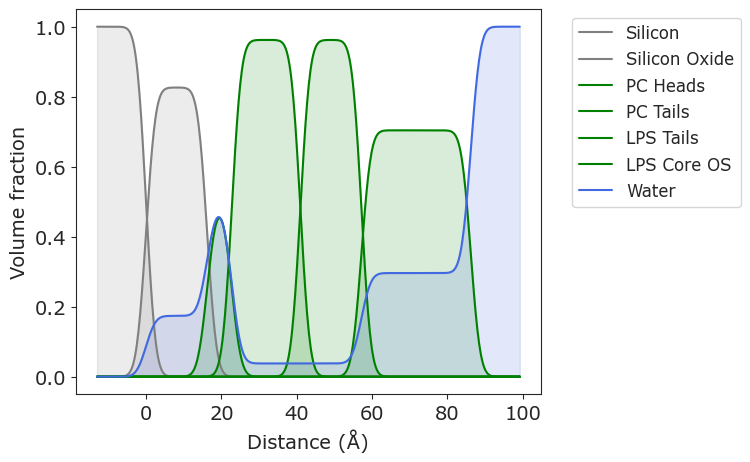

In [272]:
#Volume fraction plot of the bilayer at RT
import seaborn as sns

# Set style
sns.set_style('ticks')

# Add custom labels to this list
custom_labels = ["Silicon", "Silicon Oxide", "PC Heads", "PC Tails", "LPS Tails", 'LPS Core OS', "Water"]  # Example labels
plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14 



def create_vfp(structure, solvent_slab=-1, roughness=2, labels=None):
    _slabs = structure.slabs().copy()

    if roughness is not None:
        _slabs[:, 3] = roughness
        
    # Create an array of hydration values for each slab in the structure
    hydration_values = np.zeros(len(_slabs))

    # Assign hydration values only to the layers of the Paracini component
    hydration_values[1:6] = np.array([ S1_l_sio2.vfsolv,
                                       a.inner_head_hydration.value,
                                       a.tails_hydration.value,
                                       a.tails_hydration.value,
                                       a.core_hydration.value])
                                                                       
    vf = 1 - hydration_values
    
    if solvent_slab is None:
        nvfp = len(_slabs) + 1
    else:
        nvfp = len(_slabs)
    
    z, sldp = sld_profile(_slabs) 
    vfp = np.zeros((nvfp, len(z)), float)
    
    for i in range(len(_slabs)):
        _slabs[:, 1:3] = 0
        _slabs[i, 1] = vf[i]
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[i] = _vfp
    
    # fix up the solvent vfp
    _slabs[:, 1] = hydration_values

    if solvent_slab is None:
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[-1] = _vfp
    else:
        _slabs[solvent_slab, 1] = 1
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[solvent_slab] = _vfp

    return z, vfp

z, vfp = create_vfp(S1_s_d2o_rt, solvent_slab=-1, labels=custom_labels)

# Define your custom color mapping here
custom_colors = {
    "Silicon": "grey",
    "Silicon Oxide": "grey",
    "PC Heads": "green",
    "PC Tails": "green",
    "LPS Tails": "green",
    'LPS Core OS': "green",
    "Water": "royalblue"
}

fig3 = plt.figure(figsize=(6, 5))

for i in range(len(vfp)):
    label = custom_labels[i]
    color = custom_colors.get(label, 'gray')  # Default to 'gray' if label is not in custom_colors
    plt.plot(z, vfp[i], label=label, color=color)
    plt.fill_between(z, 0, vfp[i], color=color, alpha=0.15)  # Shading under the line plot

plt.ylabel('Volume fraction')
plt.xlabel('Distance (Å)')
plt.xticks()  
plt.yticks()  

# Adding a legend
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left', fontsize=12)

plt.savefig('S1_VF_RT_TOC.png', dpi=300, bbox_inches='tight')
plt.show()

# --------------------------------EXPORT-----------------------------------------

# import pandas as pd

# # Function to create the volume fraction plot data
# def create_vfp_data(z, vfp, labels):
#     # Initialize a dictionary to store data
#     data = {'Distance (Å)': z}
    
#     # Add each volume fraction profile to the dictionary
#     for i, label in enumerate(labels):
#         data[label] = vfp[i]
    
#     return pd.DataFrame(data)

# # Generate the volume fraction profile data
# z, vfp = create_vfp(S1_s_d2o_rt, solvent_slab=-1, labels=custom_labels)

# # Create a DataFrame from the volume fraction profile data
# vfp_data = create_vfp_data(z, vfp, custom_labels)

# # Export the DataFrame to a CSV file
# vfp_data.to_csv('S1_RT_volume_fraction_profiles_7.csv', index=False)

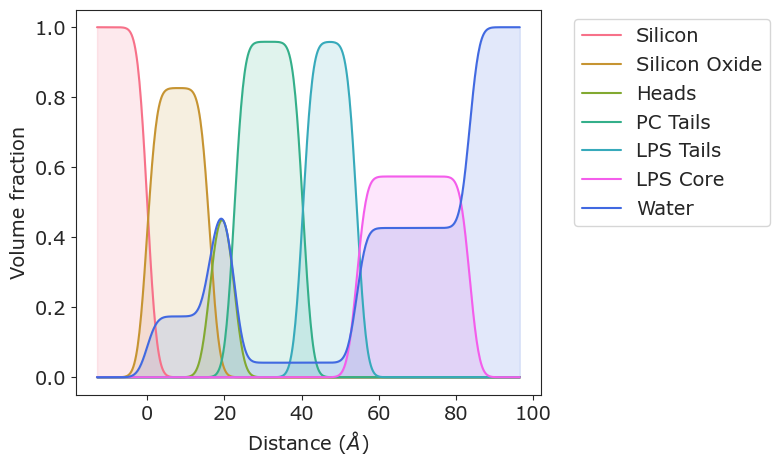

In [285]:
#Volume fraction plot of the bilayer at 37C
import seaborn as sns

# Set style
sns.set_style('ticks')

# Add custom labels to this list
custom_labels = ["Silicon", "Silicon Oxide", "Heads", "PC Tails", "LPS Tails", 'LPS Core', "Water"]  # Example labels
plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14 


def create_vfp(structure, solvent_slab=-1, roughness=2, labels=None):
    _slabs = structure.slabs().copy()

    if roughness is not None:
        _slabs[:, 3] = roughness
        
    # Create an array of hydration values for each slab in the structure
    hydration_values = np.zeros(len(_slabs))

    # Assign hydration values only to the layers of the Paracini component
    hydration_values[1:6] = np.array([ S1_l_sio2.vfsolv,
                                       b.inner_head_hydration.value,
                                       b.tails_hydration.value,
                                       b.tails_hydration.value,
                                       b.core_hydration.value])
                                                                       
    vf = 1 - hydration_values
    
    if solvent_slab is None:
        nvfp = len(_slabs) + 1
    else:
        nvfp = len(_slabs)
    
    z, sldp = sld_profile(_slabs) 
    vfp = np.zeros((nvfp, len(z)), float)
    
    for i in range(len(_slabs)):
        _slabs[:, 1:3] = 0
        _slabs[i, 1] = vf[i]
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[i] = _vfp
    
    # fix up the solvent vfp
    _slabs[:, 1] = hydration_values

    if solvent_slab is None:
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[-1] = _vfp
    else:
        _slabs[solvent_slab, 1] = 1
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[solvent_slab] = _vfp

    return z, vfp

z, vfp = create_vfp(S1_s_d2o_37, solvent_slab=-1, labels=custom_labels)

# Get the "Paired" color palette from Seaborn
colors = sns.color_palette('husl', len(vfp))

# Swap the colors of the last two elements
colors[-2], colors[-1] = colors[-1], colors[-2]

# Set the color of the last element to 'royalblue'
colors[-1] = 'royalblue'

fig3 = plt.figure(figsize=(6, 5))

for i in range(len(vfp)):
    sns.lineplot(x=z, y=vfp[i], label=custom_labels[i], color=colors[i])
    plt.fill_between(z, 0, vfp[i], color=colors[i], alpha=0.15)  # Shading under the line plot
    plt.ylabel('Volume fraction')
    plt.xlabel('Distance ($\\AA$)')
    plt.xticks()  
    plt.yticks()  

# Adding a legend
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.savefig('S1_VF_37.png', dpi=300, bbox_inches='tight')

plt.show()

# --------------------------------EXPORT-----------------------------------------


# import pandas as pd

# # Function to create the volume fraction plot data
# def create_vfp_data(z, vfp, labels):
#     # Initialize a dictionary to store data
#     data = {'Distance (Å)': z}
    
#     # Add each volume fraction profile to the dictionary
#     for i, label in enumerate(labels):
#         data[label] = vfp[i]
    
#     return pd.DataFrame(data)

# # Generate the volume fraction profile data
# z, vfp = create_vfp(S1_s_d2o_rt, solvent_slab=-1, labels=custom_labels)

# # Create a DataFrame from the volume fraction profile data
# vfp_data = create_vfp_data(z, vfp, custom_labels)

# # Export the DataFrame to a CSV file
# vfp_data.to_csv('S1_37_volume_fraction_profiles_7.csv', index=False)

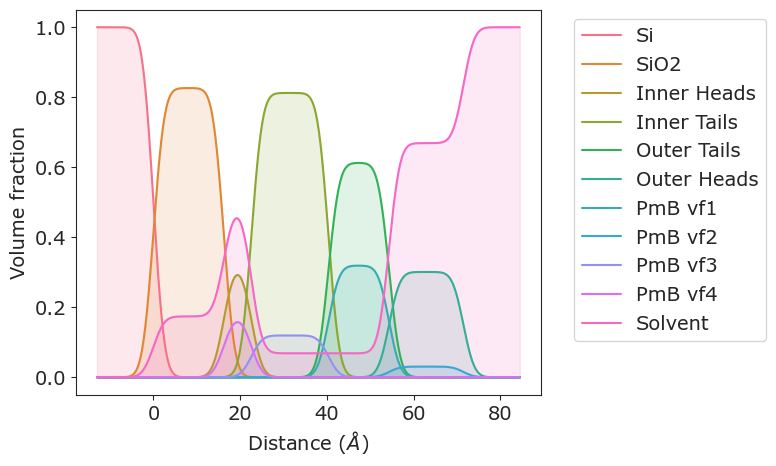

In [287]:
#Volume fraction plot of the bilayer at 37C + PmB, with individual VF in each layer
import numpy as np
import matplotlib.pyplot as plt
from refnx.reflect import sld_profile  

plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14 

def create_vfp(structure, pmb_layers, solvent_slab=-1, roughness=2):
    _slabs = structure.slabs().copy()

    if roughness is not None:
        _slabs[:, 3] = roughness

    # Array of hydration values for each slab in the structure
    hydration_values = np.zeros(len(_slabs))

    # Assign hydration values to the layers of the Paracini component
    hydration_values[1:6] = np.array([S1_l_sio2.vfsolv,
                                      c.inner_head_hydration.value,
                                      c.tails_hydration.value,
                                      c.tails_hydration.value,
                                      c.core_hydration.value])

    # Mapping pmb volume fractions to the specified layers 5:outer heads, 4:outer tails ...
    pmb_vf_map = {5: c.pmb_vf1.value, 4: c.pmb_vf2.value, 3: c.pmb_vf3.value, 2: c.pmb_vf4.value}

    vf = 1 - hydration_values
    
    # Subtract pmb volume fraction from the total volume fraction in the specified layers
    for layer in pmb_layers:
        vf[layer] = 1 - (hydration_values[layer] + pmb_vf_map[layer])


    nvfp = len(_slabs) + len(pmb_layers)

    z, sldp = sld_profile(_slabs) 
    vfp = np.zeros((nvfp, len(z)), float)

    for i in range(len(_slabs)):
        _slabs[:, 1:3] = 0
        _slabs[i, 1] = vf[i]
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[i] = _vfp

    for idx, layer in enumerate(pmb_layers):
        _slabs[:, 1:3] = 0
        _slabs[layer, 1] = pmb_vf_map[layer]
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[len(_slabs) + idx - 1] = _vfp

    _slabs[:, 1] = hydration_values
    _slabs[solvent_slab, 1] = 1
    _vfp = sld_profile(_slabs, z=z)[1]
    vfp[solvent_slab] = _vfp

    return z, vfp

z, vfp = create_vfp(S1_s_d2o_pmb, pmb_layers=[4, 5, 3, 2])  # Specify which layers contain pmb

# Plotting each volume fraction profile
# Define labels for each volume fraction profile
labels = [
    'Si', 'SiO2', 'Inner Heads', 
    'Inner Tails', 'Outer Tails', 'Outer Heads', 
    'PmB vf1', 'PmB vf2','PmB vf3', 'PmB vf4', 'Solvent'
]

# Plotting each volume fraction profile with labels


colors = sns.color_palette('husl', len(vfp))

fig3 = plt.figure(figsize=(6, 5))

for i in range(len(vfp)):
    sns.lineplot(x=z, y=vfp[i], label=labels[i], color=colors[i])
    plt.fill_between(z, 0, vfp[i], color=colors[i], alpha=0.15)  # Shading under the line plot
    plt.ylabel('Volume fraction')
    plt.xlabel('Distance ($\\AA$)')
    plt.xticks()  
    plt.yticks()  
    
# Adding a legend
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()


# --------------------------------EXPORT-----------------------------------------


# import pandas as pd

# # Function to create the volume fraction plot data
# def create_vfp_data(z, vfp, labels):
#     # Initialize a dictionary to store data
#     data = {'Distance (Å)': z}
    
#     # Add each volume fraction profile to the dictionary
#     for i, label in enumerate(labels):
#         data[label] = vfp[i]
    
#     return pd.DataFrame(data)

# # Generate the volume fraction profile data for 37C + PmB
# z, vfp = create_vfp(S1_s_d2o_pmb, pmb_layers=[4, 5, 3, 2])  # Specify which layers contain PmB

# # Define labels for each volume fraction profile
# labels = [
#     'Si', 'SiO2', 'Inner Heads', 
#     'Inner Tails', 'Outer Tails', 'Outer Heads', 
#     'PmB vf1', 'PmB vf2', 'PmB vf3', 'PmB vf4', 'Solvent'
# ]

# # Create a DataFrame from the volume fraction profile data
# vfp_data = create_vfp_data(z, vfp, labels)

# # Export the DataFrame to a CSV file
# vfp_data.to_csv('S1_PmB_volume_fraction_profiles.csv', index=False)


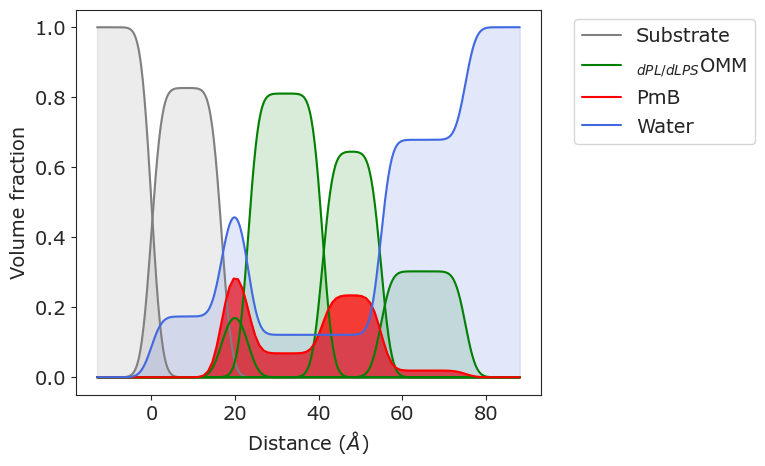

In [298]:
#Volume fraction plot of the bilayer at 37C + PmB, with unified PmB distribution

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
from scipy.interpolate import interp1d
import numpy as np

z, vfp = create_vfp(S3_s_d2o_pmb, pmb_layers=[4, 5, 3, 2])  # Specify which layers contain pmb

# Define labels for each volume fraction profile
labels = [
    'Si', 'SiO2', 'Inner Heads', 
    'Inner Tails', 'Outer Tails', 'Outer Heads', 
    'Total PmB vf', 'Solvent'
]

plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14
fig, ax = plt.subplots(figsize=(6, 5))

# Define colors for different types of layers
color_pmb = 'red'       # Pastel red
color_lipid = 'green'     # Pastel green
color_other = 'grey'   # Light grey
color_solvent = 'royalblue'   # Pastel blue

# Plot Si, SiO2, Solvent, and lipid layers
for i in range(6):  # Indices of Si, SiO2, Inner Heads, Inner Tails, Outer Tails, Outer Heads
    color = color_lipid if i >= 2 and i <= 5 else color_other
    ax.plot(z, vfp[i], color=color)
    ax.fill_between(z, 0, vfp[i], color=color, alpha=0.15)

# Interpolate PmB volume fractions
pmb_z = np.linspace(min(z), max(z), 100)  # Create points for interpolation
pmb_vf = np.zeros_like(pmb_z)
for layer in [6, 7, 8, 9]:  # Indices of PmB layers in vfp
    pmb_vf += interp1d(z, vfp[layer], kind='linear', fill_value="extrapolate")(pmb_z)

ax.plot(pmb_z, pmb_vf, color=color_pmb)
ax.fill_between(pmb_z, 0, pmb_vf, color=color_pmb, alpha=0.75)

# Plot solvent layer
ax.plot(z, vfp[-1], color=color_solvent)
ax.fill_between(z, 0, vfp[-1], color=color_solvent, alpha=0.15)

# Custom Legend Handles
legend_elements = [
    mlines.Line2D([], [], color=color_other, label='Substrate', linestyle='-'),
    mlines.Line2D([], [], color=color_lipid, label='$_{dPL/dLPS}$OMM', linestyle='-'),
    mlines.Line2D([], [], color=color_pmb, label='PmB', linestyle='-'),
    mlines.Line2D([], [], color=color_solvent, label='Water', linestyle='-')
]

ax.set_ylabel('Volume fraction')
ax.set_xlabel('Distance ($\\AA$)')
ax.legend(handles=legend_elements, bbox_to_anchor=(1.05, 1), loc='upper left')

# plt.savefig('S3_VF_PmB_TOC.png', dpi=300, bbox_inches='tight')
plt.show()


# S3 VF Plots

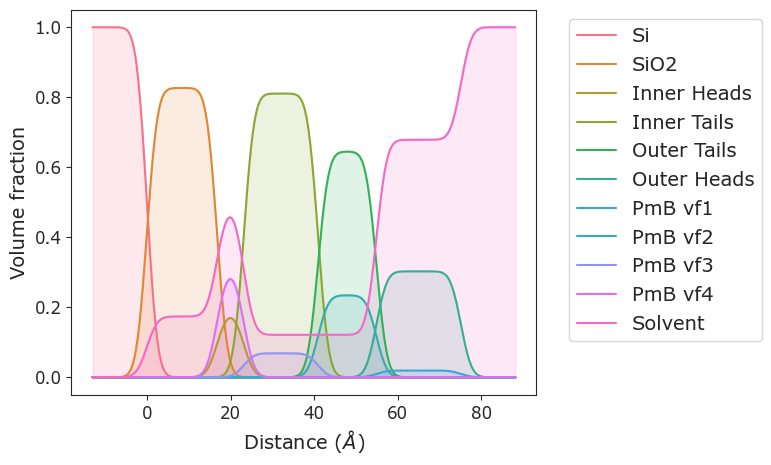

In [291]:
#Volume fraction plot of the bilayer at 37C + PmB, with individual VF in each layer
import numpy as np
import matplotlib.pyplot as plt
from refnx.reflect import sld_profile  

def create_vfp(structure, pmb_layers, solvent_slab=-1, roughness=2):
    _slabs = structure.slabs().copy()

    if roughness is not None:
        _slabs[:, 3] = roughness

    # Array of hydration values for each slab in the structure
    hydration_values = np.zeros(len(_slabs))

    # Assign hydration values to the layers of the Paracini component
    hydration_values[1:6] = np.array([S3_l_sio2.vfsolv,
                                      d.inner_head_hydration.value,
                                      d.tails_hydration.value,
                                      d.tails_hydration.value,
                                      d.core_hydration.value])

    # Mapping pmb volume fractions to the specified layers 5:outer heads, 4:outer tails ...
    pmb_vf_map = {5: d.pmb_vf1.value, 4: d.pmb_vf2.value, 3: d.pmb_vf3.value, 2: d.pmb_vf4.value}

    vf = 1 - hydration_values
    
    # Subtract pmb volume fraction from the total volume fraction in the specified layers
    for layer in pmb_layers:
        vf[layer] = 1 - (hydration_values[layer] + pmb_vf_map[layer])


    nvfp = len(_slabs) + len(pmb_layers)

    z, sldp = sld_profile(_slabs) 
    vfp = np.zeros((nvfp, len(z)), float)

    for i in range(len(_slabs)):
        _slabs[:, 1:3] = 0
        _slabs[i, 1] = vf[i]
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[i] = _vfp

    for idx, layer in enumerate(pmb_layers):
        _slabs[:, 1:3] = 0
        _slabs[layer, 1] = pmb_vf_map[layer]
        _vfp = sld_profile(_slabs, z=z)[1]
        vfp[len(_slabs) + idx - 1] = _vfp

    _slabs[:, 1] = hydration_values
    _slabs[solvent_slab, 1] = 1
    _vfp = sld_profile(_slabs, z=z)[1]
    vfp[solvent_slab] = _vfp

    return z, vfp

z, vfp = create_vfp(S3_s_d2o_pmb, pmb_layers=[4, 5, 3, 2])  # Specify which layers contain pmb

# Plotting each volume fraction profile
# Define labels for each volume fraction profile
labels = [
    'Si', 'SiO2', 'Inner Heads', 
    'Inner Tails', 'Outer Tails', 'Outer Heads', 
    'PmB vf1', 'PmB vf2','PmB vf3', 'PmB vf4', 'Solvent'
]

# Plotting each volume fraction profile with labels


colors = sns.color_palette('husl', len(vfp))

fig3 = plt.figure(figsize=(6, 5))

for i in range(len(vfp)):
    sns.lineplot(x=z, y=vfp[i], label=labels[i], color=colors[i])
    plt.fill_between(z, 0, vfp[i], color=colors[i], alpha=0.15)  # Shading under the line plot
    plt.ylabel('Volume fraction')
    plt.xlabel('Distance ($\\AA$)')
    plt.xticks(fontsize=12)  
    plt.yticks(fontsize=12)  
    
# Adding a legend
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

# --------------------------------EXPORT-----------------------------------------


# import pandas as pd

# # Function to create the volume fraction plot data
# def create_vfp_data(z, vfp, labels):
#     # Initialize a dictionary to store data
#     data = {'Distance (Å)': z}
    
#     # Add each volume fraction profile to the dictionary
#     for i, label in enumerate(labels):
#         data[label] = vfp[i]
    
#     return pd.DataFrame(data)

# # Generate the volume fraction profile data for 37C + PmB
# z, vfp = create_vfp(S1_s_d2o_pmb, pmb_layers=[4, 5, 3, 2])  # Specify which layers contain PmB

# # Define labels for each volume fraction profile
# labels = [
#     'Si', 'SiO2', 'Inner Heads', 
#     'Inner Tails', 'Outer Tails', 'Outer Heads', 
#     'PmB vf1', 'PmB vf2', 'PmB vf3', 'PmB vf4', 'Solvent'
# ]

# # Create a DataFrame from the volume fraction profile data
# vfp_data = create_vfp_data(z, vfp, labels)

# # Export the DataFrame to a CSV file
# vfp_data.to_csv('S3_PmB_volume_fraction_profiles.csv', index=False)

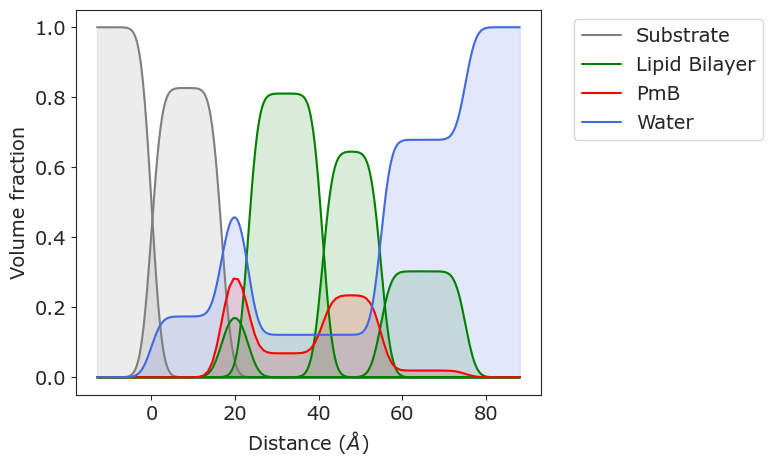

In [292]:
#Volume fraction plot of the bilayer at 37C + PmB, with unified PmB distribution

import matplotlib.pyplot as plt
import matplotlib.lines as mlines
from scipy.interpolate import interp1d
import numpy as np

z, vfp = create_vfp(S3_s_d2o_pmb, pmb_layers=[4, 5, 3, 2])  # Specify which layers contain pmb

# Define labels for each volume fraction profile
labels = [
    'Si', 'SiO2', 'Inner Heads', 
    'Inner Tails', 'Outer Tails', 'Outer Heads', 
    'Total PmB vf', 'Solvent'
]

plt.rcParams['font.family'] = 'Verdana'
plt.rcParams['font.size'] = 14
fig, ax = plt.subplots(figsize=(6, 5))

# Define colors for different types of layers
color_pmb = 'red'       # Pastel red
color_lipid = 'green'     # Pastel green
color_other = 'grey'   # Light grey
color_solvent = 'royalblue'   # Pastel blue

# Plot Si, SiO2, Solvent, and lipid layers
for i in range(6):  # Indices of Si, SiO2, Inner Heads, Inner Tails, Outer Tails, Outer Heads
    color = color_lipid if i >= 2 and i <= 5 else color_other
    ax.plot(z, vfp[i], color=color)
    ax.fill_between(z, 0, vfp[i], color=color, alpha=0.15)

# Interpolate PmB volume fractions
pmb_z = np.linspace(min(z), max(z), 100)  # Create points for interpolation
pmb_vf = np.zeros_like(pmb_z)
for layer in [6, 7, 8, 9]:  # Indices of PmB layers in vfp
    pmb_vf += interp1d(z, vfp[layer], kind='linear', fill_value="extrapolate")(pmb_z)

ax.plot(pmb_z, pmb_vf, color=color_pmb)
ax.fill_between(pmb_z, 0, pmb_vf, color=color_pmb, alpha=0.15)

# Plot solvent layer
ax.plot(z, vfp[-1], color=color_solvent)
ax.fill_between(z, 0, vfp[-1], color=color_solvent, alpha=0.15)

# Custom Legend Handles
legend_elements = [
    mlines.Line2D([], [], color=color_other, label='Substrate', linestyle='-'),
    mlines.Line2D([], [], color=color_lipid, label='Lipid Bilayer', linestyle='-'),
    mlines.Line2D([], [], color=color_pmb, label='PmB', linestyle='-'),
    mlines.Line2D([], [], color=color_solvent, label='Water', linestyle='-')
]

ax.set_ylabel('Volume fraction')
ax.set_xlabel('Distance ($\\AA$)')
ax.legend(handles=legend_elements, bbox_to_anchor=(1.05, 1), loc='upper left')

plt.savefig('S3_VF_PmB.png', dpi=300, bbox_inches='tight')
plt.show()


# Error Analysis

In [66]:
fitter.reset()

In [67]:
res = fitter.sample(10, nthin=150, pool=1)

100%|███████████████████████████████████████████████| 1500/1500 [23:45<00:00,  1.05it/s]


# Corner Plot

In [68]:
global_objective.corner();
plt.savefig('S1_S3_CornerPlot_2APM-1hydration-4PmBvf_5')

# Sampled SLD Profiles

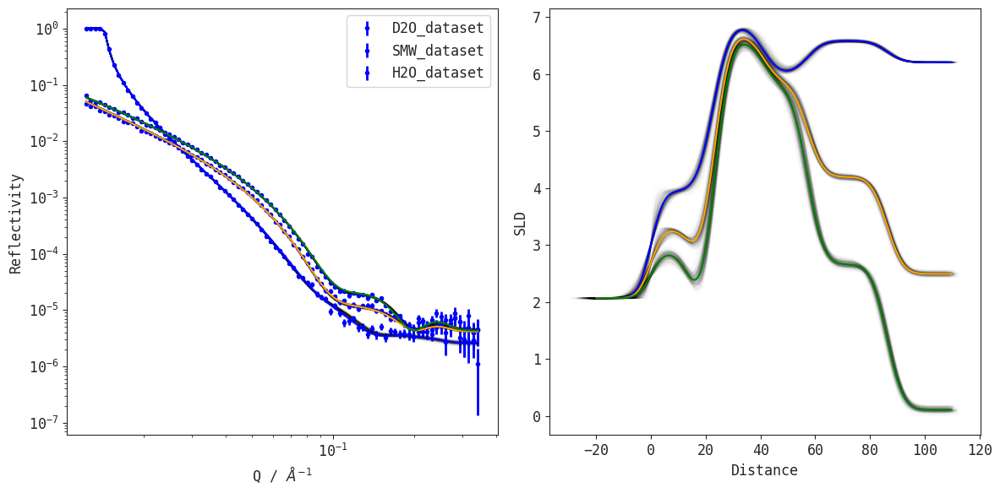

In [119]:
import matplotlib.pyplot as plt

# Create a figure with two subplots (1 row, 2 columns)
fig, axs = plt.subplots(1, 2, figsize=(12, 6))

# Plotting for Figure 1 on the first subplot
plt.sca(axs[0])  # Set the current axes to the first subplot
f, w = S1_objective_d2o_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('blue')
f, w = S1_objective_smw_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('orange')
f, w = S1_objective_h2o_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('green')

axs[0].set_yscale('log')
axs[0].set_xscale('log')
axs[0].set_xlabel('Q / $\AA^{-1}$')
axs[0].set_ylabel('Reflectivity')
axs[0].legend()

# Plotting for Figure 2 on the second subplot
plt.sca(axs[1])  # Set the current axes to the second subplot
f, w = S1_s_d2o_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('blue')
f, w = S1_s_smw_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('orange')
f, w = S1_s_h2o_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('green')

axs[1].set_yscale('linear')
axs[1].set_xscale('linear')
axs[1].set_xlabel('Distance')
axs[1].set_ylabel('SLD')
# axs[1].legend()

# Adjust layout
plt.tight_layout()

# Show the combined plot
plt.show()


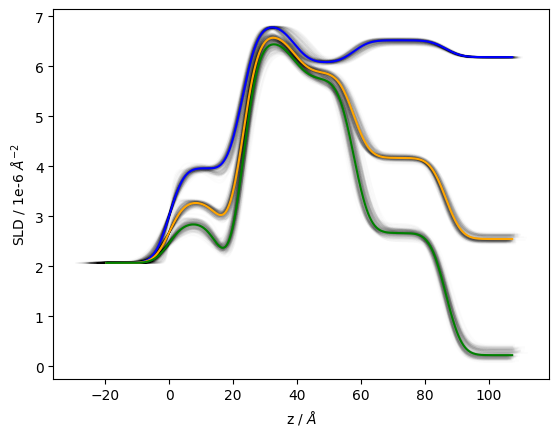

In [136]:
fig, ax = plt.subplots()
f, w = S1_s_d2o_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('blue')
f, w = S1_s_smw_rt.plot(samples=200, fig=fig)
w.lines[-1].set_color('orange')
f, w = S1_s_h2o_rt.plot(samples=200, fig=fig);
w.lines[-1].set_color('green');

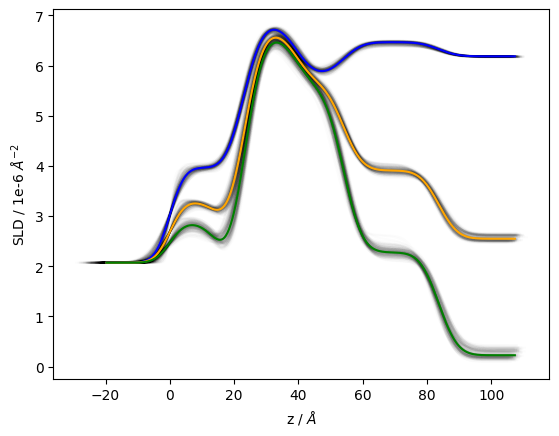

In [137]:
fig, ax = plt.subplots()
f, w = S1_s_d2o_37.plot(samples=200, fig=fig)
w.lines[-1].set_color('blue')
f, w = S1_s_smw_37.plot(samples=200, fig=fig)
w.lines[-1].set_color('orange')
f, w = S1_s_h2o_37.plot(samples=200, fig=fig);
w.lines[-1].set_color('green');

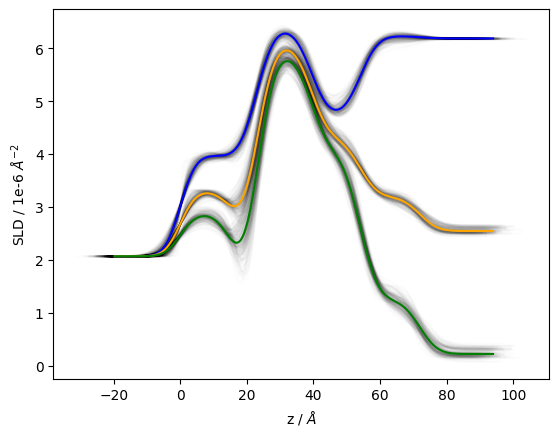

In [138]:
fig, ax = plt.subplots()
f, w = S1_s_d2o_pmb.plot(samples=200, fig=fig)
w.lines[-1].set_color('blue')
f, w = S1_s_smw_pmb.plot(samples=200, fig=fig)
w.lines[-1].set_color('orange')
f, w = S1_s_h2o_pmb.plot(samples=200, fig=fig);
w.lines[-1].set_color('green');

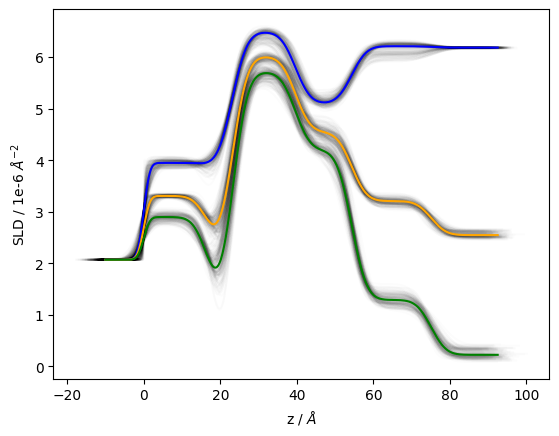

In [139]:
fig, ax = plt.subplots()
f, w = S3_s_d2o_pmb.plot(samples=200, fig=fig)
w.lines[-1].set_color('blue')
f, w = S3_s_smw_pmb.plot(samples=200, fig=fig)
w.lines[-1].set_color('orange')
f, w = S3_s_h2o_pmb.plot(samples=200, fig=fig);
w.lines[-1].set_color('green');

# Fitted Parameters

In [103]:
#Display only the values that have been fitted plus other useful metrics
fitted_parameters = global_objective.parameters.varying_parameters() # List varying parameters
print(fitted_parameters)
print("number of fitted parameters: ", len(fitted_parameters)) 

number_of_exp_points =  len(S1_data_d2o_rt) +  len(S1_data_smw_rt) +  len(S1_data_h2o_rt) 
number_of_exp_points += len(S1_data_d2o_37) +  len(S1_data_smw_37) +  len(S1_data_h2o_37)  
number_of_exp_points += len(S1_data_d2o_pmb) + len(S1_data_smw_pmb) + len(S1_data_h2o_pmb)  
number_of_exp_points += len(S3_data_d2o_rt) +  len(S3_data_smw_rt) +  len(S3_data_h2o_rt) 
number_of_exp_points += len(S3_data_d2o_37) +  len(S3_data_smw_37) +  len(S3_data_h2o_37)  
number_of_exp_points += len(S3_data_d2o_pmb) + len(S3_data_smw_pmb) + len(S3_data_h2o_pmb)  

print(" Number of experimental points: ", number_of_exp_points)
number_of_fitted_par = len(fitted_parameters)
print(" Number of fitted parameters: ", number_of_fitted_par)

chisquared =  S1_objective_d2o_rt.chisqr() +  S1_objective_smw_rt.chisqr() +  S1_objective_h2o_rt.chisqr()
chisquared += S1_objective_d2o_37.chisqr() +  S1_objective_smw_37.chisqr() +  S1_objective_h2o_37.chisqr()
chisquared += S1_objective_d2o_pmb.chisqr() + S1_objective_smw_pmb.chisqr() + S1_objective_h2o_pmb.chisqr()
chisquared += S3_objective_d2o_rt.chisqr() +  S3_objective_smw_rt.chisqr() +  S3_objective_h2o_rt.chisqr()
chisquared += S3_objective_d2o_37.chisqr() +  S3_objective_smw_37.chisqr() +  S3_objective_h2o_37.chisqr()
chisquared += S3_objective_d2o_pmb.chisqr() + S3_objective_smw_pmb.chisqr() + S3_objective_h2o_pmb.chisqr()

print(" chi^2 = ", chisquared)


print(" Reduced chi^2 = ", chisquared / (number_of_exp_points - number_of_fitted_par ))

________________________________________________________________________________
Parameters:      None      
<Parameter: 'S1_scale_rt' , value=1.01447 +/- 0.00441, bounds=[0.8, 1.2]>
<Parameter:    'Bkg1'     , value=2.57388e-06 +/- 1.25e-07, bounds=[1e-08, 6e-06]>
<Parameter:'S1 SiO2 Thickness', value=16.2064 +/- 0.509, bounds=[2.0, 30.0]>
<Parameter:'S1 SiO2 Roughness', value=3.7295 +/- 1.05 , bounds=[0.0, 7.0]>
<Parameter:'S1 SiO2 Solvation', value=0.173781 +/- 0.0124, bounds=[0.0, 0.5]>
<Parameter:'inner_head_hydration', value=0.494967 +/- 0.032, bounds=[0.2, 0.6]>
<Parameter:   'pc_apm'    , value=49.0073 +/- 2.44 , bounds=[0.0, 100.0]>
<Parameter:'outer_tails_thick', value=16.2011 +/- 0.712, bounds=[12.0, 20.0]>
<Parameter:'outer_tails_sld', value=5.99378 +/- 0.0448, bounds=[4.0, 8.0]>
<Parameter:'tails_hydration', value=0.0378433 +/- 0.0111, bounds=[0.0, 0.5]>
<Parameter:'outer_head_sld_d2o', value=6.80886 +/- 0.0238, bounds=[4.0, 7.0]>
<Parameter: 'outer_rough' , value=4.65226 

# Save Table of Values

In [230]:
import re
import pandas as pd

# Define a function to round numbers, preserving original notation
def round_number(value, decimals):
    try:
        original_value = float(value)
        # Check if the value is in scientific notation
        if "e" in value.lower():
            format_string = "{:." + str(decimals) + "e}"
        else:
            format_string = "{:." + str(decimals) + "f}"
        return format_string.format(original_value)
    except ValueError:
        return value

# Number of decimals to round to
decimals = 2  # You can change this to your desired number of decimal places

# Defining script_output
script_output = """
Parameters: 'instrument parameters'

________________________________________________________________________________
Parameters:      None      
<Parameter:    'Bkg1 D2O'     , value=2.57e-06 +/- 1.25e-07, bounds=[1e-08, 6e-06]>
<Parameter:    'Bkg2 SMW'     , value=4.23e-06 +/- 1.14e-07, bounds=[1e-08, 6e-06]>
<Parameter:    'Bkg3 H2O'     , value=4.37e-06 +/- 1.52e-07, bounds=[1e-08, 6e-06]>
<Parameter:    'D2O SLD'   ,value=6.20492 +/- 0.0023, bounds=[6.0, 6.36]>
<Parameter:    'SMW SLD'   ,value=2.49568 +/- 0.0251, bounds=[1.5, 3.0]>
<Parameter:    'H2O SLD'   ,value=0.112186 +/- 0.0372, bounds=[-0.56, 1.0]>
<Parameter: 'S1_scale_rt' , value=1.01447 +/- 0.00441, bounds=[0.8, 1.2]>
<Parameter: 'S1_scale_37' , value=0.885498 +/- 0.00505, bounds=[0.8, 1.2]>
<Parameter:'S1_scale_pmb' , value=0.926995 +/- 0.0131, bounds=[0.8, 1.2]>
<Parameter: 'S3_scale_rt' , value=0.976238 +/- 0.00494, bounds=[0.8, 1.2]>
<Parameter: 'S3_scale_37' , value=0.916872 +/- 0.00428, bounds=[0.8, 1.2]>
<Parameter:'S3_scale_pmb' , value=0.865128 +/- 0.00752, bounds=[0.8, 1.2]>

<Parameter:'S1 SiO2 Thickness', value=16.2064 +/- 0.509, bounds=[2.0, 30.0]>
<Parameter:'S1 SiO2 Roughness', value=3.7295 +/- 1.05 , bounds=[0.0, 7.0]>
<Parameter:'S1 SiO2 Solvation', value=0.173781 +/- 0.0124, bounds=[0.0, 0.5]>
<Parameter:'S3 SiO2 Thickness', value=16.7691 +/- 0.503, bounds=[2.0, 30.0]>
<Parameter:'S3 SiO2 Roughness', value=1.89912 +/- 0.655, bounds=[0.0, 7.0]>
<Parameter:'S3 SiO2 Solvation', value=0.173567 +/- 0.0134, bounds=[0.0, 0.5]>

<Parameter:   'pc_apm_rt'    ,       value=49.0073 +/- 2.44 , bounds=[0.0, 100.0]>
<Parameter:'inner_head_hydration',   value=0.494967 +/- 0.032, bounds=[0.2, 0.6]>
<Parameter:'outer_tails_thick',      value=16.2011 +/- 0.712, bounds=[12.0, 20.0]>
<Parameter:'outer_tails_sld',        value=5.99378 +/- 0.0448, bounds=[4.0, 8.0]>
<Parameter:'tails_hydration',        value=0.0378433 +/- 0.0111, bounds=[0.0, 0.5]>
<Parameter:'outer_head_sld_d2o',     value=6.80886 +/- 0.0238, bounds=[4.0, 7.0]>
<Parameter: 'outer_rough' ,          value=4.65226 +/- 0.304, bounds=[3.0, 8.0]>
<Parameter:'core_thickness',         value=29.0185 +/- 0.326, bounds=[20.0, 40.0]>
<Parameter:'core_hydration',         value=0.296098 +/- 0.014, bounds=[0.0, 1.0]>
  
<Parameter:  'pc_apm_37'  ,          value=50.2141 +/- 2.52 , bounds=[0.0, 100.0]>
<Parameter:'outer_tails_thick_37',   value=13.9719 +/- 1.06 , bounds=[10.0, 20.0]>
<Parameter:'outer_tails_sld_37',     value=5.70671 +/- 0.0738, bounds=[4.0, 7.0]>
<Parameter:'tails_hydration_37',     value=0.0415483 +/- 0.0109, bounds=[0.0, 0.3]>
<Parameter:'outer_rough_37',         value=4.36453 +/- 0.434, bounds=[2.0, 8.0]>
<Parameter:'core_thickness_37',      value=29.2239 +/- 0.364, bounds=[20.0, 35.0]>
<Parameter:'core_hydration_37',      value=0.426439 +/- 0.0174, bounds=[0.2, 0.7]>

<Parameter:'S1_tails_hydration_pmb', value=0.0684056 +/- 0.0134, bounds=[0.0, 0.3]>
<Parameter:'S1_outer_rough_pmb',     value=3.87019 +/- 0.791, bounds=[2.0, 8.0]>
<Parameter:'S1_core_thickness_pmb',  value=17.1517 +/- 0.965, bounds=[10.0, 35.0]>
<Parameter:'S1_core_hydration_pmb',  value=0.668884 +/- 0.0427, bounds=[0.0, 1.0]>
<Parameter: 'S1_pmb_vf1'  ,          value=0.0303515 +/- 0.018, bounds=[0.0, 0.5]>
<Parameter: 'S1_pmb_vf2'  ,          value=0.31897 +/- 0.0367, bounds=[0.0, 0.5]>
<Parameter: 'S1_pmb_vf3'  ,          value=0.119336 +/- 0.012, bounds=[0.0, 0.5]>
<Parameter: 'S1_pmb_vf4'  ,          value=0.176884 +/- 0.118, bounds=[0.0, 0.5]>

<Parameter:'S3_tails_hydration_pmb', value=0.121124 +/- 0.00984, bounds=[0.0, 0.3]>
<Parameter:'S3_outer_rough_pmb',     value=3.48662 +/- 0.534, bounds=[2.0, 8.0]>
<Parameter:'S3_core_thickness_pmb',  value=20.2115 +/- 0.952, bounds=[10.0, 35.0]>
<Parameter:'S3_core_hydration_pmb',  value=0.67841 +/- 0.0341, bounds=[0.0, 1.0]>
<Parameter: 'S3_pmb_vf1'  ,          value=0.0190647 +/- 0.0103, bounds=[0.0, 0.5]>
<Parameter: 'S3_pmb_vf2'  ,          value=0.23409 +/- 0.0287, bounds=[0.0, 0.5]>
<Parameter: 'S3_pmb_vf3'  ,          value=0.0683436 +/- 0.01 , bounds=[0.0, 0.5]>
<Parameter: 'S3_pmb_vf4'  ,          value=0.315007 +/- 0.111, bounds=[0.0, 0.5]>

number of fitted parameters:  50
 Number of experimental points:  1547
 Number of fitted parameters:  50
 chi^2 =  4147.65265912277
 Reduced chi^2 =  2.770643058866246
_________________________________________________________________________________

"""

# Extracting parameters_info again
parameters_info = re.findall(r'<Parameter:.*?>', script_output)

# Extracting the values
parameter_data = []
for parameter in parameters_info:
    name = re.search(r"'(.*?)'", parameter).group(1)
    value_match = re.search(r'value=([-+]?\d+(\.\d+)?(e[-+]?\d+)?)', parameter)
    error_match = re.search(r'\+/-\s*([-+]?\d+(\.\d+)?(e[-+]?\d+)?)', parameter)
    
    value = round_number(value_match.group(1), decimals) if value_match else 'NA'
    error = '±' + round_number(error_match.group(1), decimals) if error_match else 'NA'
    
    # Extract bounds information or set to "NA" if value is fixed
    bounds_match = re.search(r'bounds=\[(.*?)\]', parameter)
    bounds = bounds_match.group(1).split(', ') if bounds_match else 'NA'
    
    parameter_data.append({'Parameter': name, 'Value': value, 'Error': error, 'Bounds': bounds})

# Creating the Pandas DataFrame
df = pd.DataFrame(parameter_data)

# Save to CSV
df.to_csv('2APM-1hydration-4PmBvf_7_Table_full.csv', index=False)


# Save Objectives

In [84]:
import pickle

# List of your objectives
ss = [S1_objective_d2o_rt,  S1_objective_smw_rt,  S1_objective_h2o_rt, 
      S1_objective_d2o_37,  S1_objective_smw_37,  S1_objective_h2o_37,
      S1_objective_d2o_pmb, S1_objective_smw_pmb, S1_objective_h2o_pmb,
      S3_objective_d2o_rt,  S3_objective_smw_rt,  S3_objective_h2o_rt, 
      S3_objective_d2o_37,  S3_objective_smw_37,  S3_objective_h2o_37,
      S3_objective_d2o_pmb, S3_objective_smw_pmb, S3_objective_h2o_pmb,]

# Corresponding names for the files
names = ['S1_objective_d2o_rt',  'S1_objective_smw_rt',  'S1_objective_h2o_rt', 
         'S1_objective_d2o_37',  'S1_objective_smw_37',  'S1_objective_h2o_37',
         'S1_objective_d2o_pmb', 'S1_objective_smw_pmb', 'S1_objective_h2o_pmb',
         'S3_objective_d2o_rt',  'S3_objective_smw_rt',  'S3_objective_h2o_rt', 
         'S3_objective_d2o_37',  'S3_objective_smw_37',  'S3_objective_h2o_37',
         'S3_objective_d2o_pmb', 'S3_objective_smw_pmb', 'S3_objective_h2o_pmb',]

# Create a dictionary mapping names to objects
sobjective_dict = dict(zip(names, ss))

# Iterate through the dictionary and pickle each object, also save its representation
for name, obj in sobjective_dict.items():
    # Save the binary serialized object
    with open(f'saved_{name}.pkl', 'wb+') as f:
        pickle.dump(obj, f)
    
    # Save the human-readable representation
    with open(f'saved_{name}_repr.txt', 'w+') as f:
        f.write(repr(obj))


# Save Data and Fits

In [87]:
import pandas as pd

# Function to add dataset columns to the DataFrame
def add_dataset_columns(df, y, y_err, model_y, label):
    df[f'{label} Y'] = y[:85]  # Truncate to 85 data points
    df[f'{label} Y Error'] = y_err[:85]
    df[f'{label} Model Y'] = model_y[:85]
    return df

# Initialize an empty DataFrame with the shared x-axis values from the first dataset
x_values = S1_objectives[0].data.x[:85]  # Truncate to 85 data points
all_data = pd.DataFrame({'X': x_values})

# Loop over each objective and add columns to the DataFrame
for i, (S1_obj, S3_obj) in enumerate(zip(S1_objectives, S3_objectives)):
    y_S1, y_err_S1 = S1_obj.data.y, S1_obj.data.y_err
    model_y_S1 = S1_obj.model(S1_objectives[0].data.x[:85])  # Truncate model y-values to 85

    y_S3, y_err_S3 = S3_obj.data.y, S3_obj.data.y_err
    model_y_S3 = S3_obj.model(S1_objectives[0].data.x[:85])  # Truncate model y-values to 85

    # Add columns for S1 and S3 to the DataFrame
    all_data = add_dataset_columns(all_data, y_S1, y_err_S1, model_y_S1, f'{S1_labels[i]}')
    all_data = add_dataset_columns(all_data, y_S3, y_err_S3, model_y_S3, f'{S3_labels[i]}')

# Export the DataFrame to a CSV file
all_data.to_csv('Data_Fits_7.csv', index=False)


# Save SLD profiles

In [82]:
import pandas as pd

# Initialize a list to hold all the DataFrames
all_sld_data = []

# List of structures and their labels
structures = [S1_s_d2o_rt,  S1_s_smw_rt,  S1_s_h2o_rt, 
              S1_s_d2o_37,  S1_s_smw_37,  S1_s_h2o_37, 
              S1_s_d2o_pmb, S1_s_smw_pmb, S1_s_h2o_pmb,
              S3_s_d2o_rt,  S3_s_smw_rt,  S3_s_h2o_rt, 
              S3_s_d2o_37,  S3_s_smw_37,  S3_s_h2o_37, 
              S3_s_d2o_pmb, S3_s_smw_pmb, S3_s_h2o_pmb]
labels = ['S1 D2O_RT',  'S1 SMW_RT',  'S1 H2O_RT', 
          'S1 D2O_37',  'S1 SMW_37',  'S1 H2O_37', 
          'S1 D2O_PmB', 'S1 SMW_PmB', 'S1 H2O_PmB',
          'S3 D2O_RT',  'S3 SMW_RT',  'S3 H2O_RT', 
          'S3 D2O_37',  'S3 SMW_37',  'S3 H2O_37', 
          'S3 D2O_PmB', 'S3 SMW_PmB', 'S3 H2O_PmB',]

# Loop over each structure and create DataFrames
for structure, label in zip(structures, labels):
    x, y = structure.sld_profile()
    sld_df = pd.DataFrame({'x': x, f'y_{label}': y})
    all_sld_data.append(sld_df)

# Concatenate all the DataFrames in the list
final_sld_df = pd.concat(all_sld_data, axis=1)

# Removing duplicate x columns
final_sld_df = final_sld_df.loc[:,~final_sld_df.columns.duplicated()]

# Save to CSV
final_sld_df.to_csv('Combined_sld_profiles_7.csv', index=False)


In [231]:
import numpy as np
import pandas as pd
import re

# Function to convert string representation of arrays to numpy arrays
def str_to_np_array(data_str):
    data_str = data_str.strip().replace('\n', '; ')
    return np.matrix(data_str)

# Function to round the dataframe values to two decimal places
def round_dataframe(df, decimals=2):
    numeric_columns = df.select_dtypes(include=[np.number]).columns
    df[numeric_columns] = df[numeric_columns].apply(lambda x: round(x, decimals))
    return df

# Your input string
input_str = '''
S1 RT Bilayer Slabs:
[[ 6.54800159  4.02168035  0.          4.65226143  0.        ]
 [18.20544413  6.84526901  0.          4.65226143  0.        ]
 [16.20111618  6.00176753  0.          4.65226143  0.        ]
 [29.01845858  6.57972031  0.          4.65226143  0.        ]]

S1 37C Bilayer Slabs:
[[ 6.39064031  4.02168035  0.          4.36453178  0.        ]
 [17.76793171  6.84280321  0.          4.36453178  0.        ]
 [13.97193823  5.72740674  0.          4.36453178  0.        ]
 [29.22387003  6.51031884  0.          4.36453178  0.        ]]

S1 37C + PmB Bilayer Slabs:
[[ 6.39064031  4.0738519   0.          3.87019427  0.        ]
 [17.76793171  6.26481867  0.          3.87019427  0.        ]
 [13.97193823  4.61488613  0.          3.87019427  0.        ]
 [17.15171058  6.24280949  0.          3.87019427  0.        ]]

S3 37C + PmB Bilayer Slabs:
[[ 6.39064031  4.11459114  0.          3.4866216   0.        ]
 [17.76793171  6.46906878  0.          3.4866216   0.        ]
 [13.97193823  4.94075982  0.          3.4866216   0.        ]
 [20.21146397  6.28921033  0.          3.4866216   0.        ]]
'''

# Splitting the input string into separate sections
sections = re.split(r'\n\n', input_str.strip())

# Creating DataFrame for each section and concatenating them
all_data = pd.DataFrame()
for section in sections:
    title, data_str = section.split(':')
    data = str_to_np_array(data_str)
    df = pd.DataFrame(data)
    df.insert(0, 'Title', title)
    all_data = pd.concat([all_data, df])

# Drop columns where all values are 0.0
all_data = all_data.loc[:, (all_data != 0.0).any(axis=0)]

# Renaming columns
column_names = ['Title', 'Thickness', 'SLD', 'Roughness']
all_data.columns = column_names[:len(all_data.columns)]

# Resetting the index
all_data.reset_index(drop=True, inplace=True)

# Round the numerical values in the dataframe
all_data = round_dataframe(all_data, decimals=2)

# Export to CSV
csv_file_path = 'Matrix_data_7.csv'
all_data.to_csv(csv_file_path, index=False)

print(f"Data exported to {csv_file_path}")


Data exported to Matrix_data_7.csv
